# Importing the necessary libraries

In [4]:
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.rcParams["figure.dpi"] = 900

In [5]:
import jax

In [6]:
np.random.seed(11111)
random.seed(11111)

# 6 Node, 10 Bar Truss

## Defining the geometery of the truss

In [7]:
E = 1e7 #68947572.93178 # KN/m^2 (10e7 psi) modulus_of_elasticity
p = 0.1  #27.1447138 # KN/m^3 (0.1 lb/in^3) weight_density
s_lim = 25000 #172368.93233 #KN/m^2 (25000 psi) # allowable_stress_compression = 172368.93233 #KN/m^2 (25000 psi)
d_lim =  2 #0.0508 #m (2 inch) #displacemnt limit

In [8]:
area_avalival = [1.62, 1.80,2.38, 2.62, 2.88, 3.09, 3.13,
3.38,3.63,3.84,3.87,4.18,4.49,4.80,4.97,5.12, 5.74, 7.22,
7.97,11.5,13.5,13.9,14.2,15.5,16.0,18.8,19.9,22.0,22.9,
26.5, 30.0, 33.5]  ## sq inch

In [9]:
nodes, bars =[], []

nodes.append([100,460]) #node0
nodes.append([460,460]) #node1
nodes.append([820,460]) #node2
nodes.append([100,100]) #node3
nodes.append([460,100]) #node4
nodes.append([820,100]) #node5

bars.append([0,1]) #bar1  #dont forget python starts with 0
bars.append([1,2]) #bar2

bars.append([3,4]) #bar3
bars.append([4,5]) #bar4


bars.append([1,4]) #bar5
bars.append([2,5]) #bar6

bars.append([0,4]) #bar7
bars.append([1,3]) #bar8

bars.append([1,5]) #bar9
bars.append([2,4]) #bar10

nodes = np.array(nodes).astype(float)
bars = np.array(bars)
original_nodes = np.copy(nodes)

In [10]:
bars

array([[0, 1],
       [1, 2],
       [3, 4],
       [4, 5],
       [1, 4],
       [2, 5],
       [0, 4],
       [1, 3],
       [1, 5],
       [2, 4]])

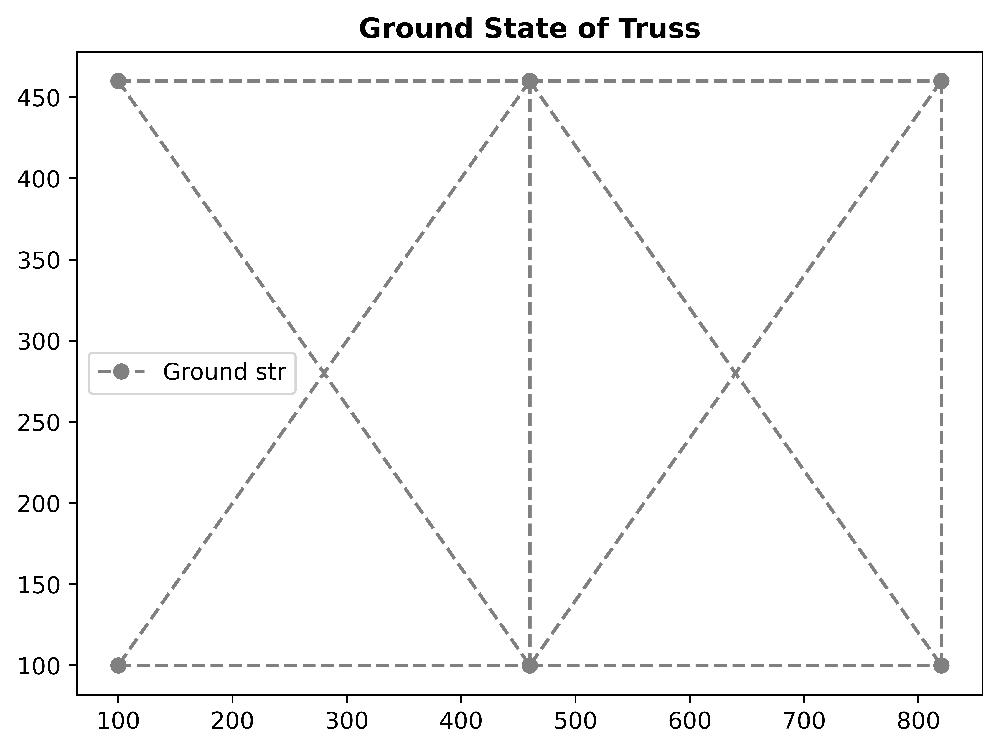

In [11]:
plt.figure(figsize=(7,5))
plt.title("Ground State of Truss", fontweight='bold')

for i in range(len(bars)):
    xi, xf = nodes[bars[i,0],0], nodes[bars[i, 1],0]
    yi, yf = nodes[bars[i, 0], 1], nodes[bars [i, 1],1]
    line, = plt.plot([xi, xf], [yi, yf], color='grey', linestyle='--', marker='o') 

line.set_label('Ground str')
plt.legend()
plt.show()

In [12]:
P = np.zeros_like(nodes) # 0 =nO LOAD # 1 == lOAD
P[4,1]= -100000
P[5,1]= -100000
print(P)

[[      0.       0.]
 [      0.       0.]
 [      0.       0.]
 [      0.       0.]
 [      0. -100000.]
 [      0. -100000.]]


In [13]:
Ur = [0,0,0,0]

In [14]:
# Defining the degrees of Freedoms
DOFCON = np.ones_like(nodes).astype(int)
DOFCON[0,:] = 0
DOFCON[3,:] = 0
print(DOFCON)

[[0 0]
 [1 1]
 [1 1]
 [0 0]
 [1 1]
 [1 1]]


## Truss Analysis
### Doing structural analysis of the truss for an constant area of 11.5 inch^2

In [15]:
@jax.jit
class basic(): 

    def min_area(area):
        computed_area =[]
        for i in area:
            if i<1:
                computed_area.append(1)
            else:
                computed_area.append(i)
        return np.array(computed_area)

    def area_gen(area):
        area_new = []
        for i in range(10):
            area_new.append(random.choice(area))
        return area_new

    def scaler(area):
        f=[]
        a = sum(area)
        for i in area:
            i=i*50
            f.append(i/a)
        return f

    def Plot(nodes, c, lt, area, lg):
        for i in range(len(bars)):
            xi, xf = nodes[bars[i,0],0], nodes[bars[i,1],0]
            yi, yf = nodes[bars[i,0],1], nodes[bars[i,1],1]
            a = np.round(basic.scaler(area), 3)
            line, = plt.plot([xi, xf], [yi,yf], color=c, linestyle=lt, linewidth=a[i],
                             label=f'\nArea : {area[i]} in^2\n', marker='o', solid_capstyle='round') #
        line, = plt.plot([xi, xf], [yi,yf], color=c, linestyle=lt, linewidth=0.001)
        line.set_label(lg)
        plt.legend(bbox_to_anchor=(1,1), loc="upper left", prop={'size':4})
    

    def check( STRESS, DEFLECTION):
        x=0
        y=0
        for i in STRESS:
            if np.abs(i) > s_lim:
                x +=1
                # print("Failed in Stress")
            else:
                pass
                #print("Pass in Stress")
        for i in range(6):
            ix = np.abs(DEFLECTION[i][0])
            iy = np.abs(DEFLECTION[i][1])
            if ix > d_lim:
                y+=1
                #print("Failed in Deflection along X")
            elif iy > d_lim:
                y +=1
                #print("Failed in Deflection along Y")
            else:
                pass
                #print("Pass in Deflection")
        if (x ==0) & (y==0):
            # print("Pass")
            return "Pass"
        else:
            # print(f'Failed in {x} ways for stress \n Failed in {y} ways for deflection ')
            return f'Failed in {x} ways for stress \n Failed in {y} ways for deflection '

@jax.jit
class Truss():
    # Truss Structural Analysis
    def TrussAnalysis(A, nodes, bars):
        NN = len(nodes) # number of nodes
        NE = len(bars) # number of deges
        # print(NE)

        DOF = 2 # defree of freedom
        NDOF = DOF*NN # total degree of freedom

        #structural analysis using direct stifness method

        # for bar no 3
        # takes info from node no 3 and substract it from infor of node no 2
        d = nodes[bars[:,1],:] - nodes[bars[:,0],:]
        
        L = np.sqrt((d**2).sum(axis=1)) #leangth of the bar
        # print(f"The Leangth is {L}")
        #computing the angle 
        angle = d.T/L
        # print(f"The angle is \n\n{angle}\n\n")
        #transformation vector {a ==Transformation vector}
        a = np.concatenate((-angle.T, angle.T), axis=1)
        # print(f"The transformation vector is \n\n{a}\n\n")

        #Global stifness matrix K
        K = np.zeros([NDOF,NDOF])
        
        
        for k in range(NE):
            aux = 2*bars[k,:]
            #gives you degree of freedom in each node
            index = np.r_[aux[0]:aux[0]+2, aux[1]:aux[1]+2]
            # print(f'a : {a.shape}, A: {A.shape}, L: {L.shape}')
            ES = np.dot(a[k][np.newaxis].T*E*A[k], a[k][np.newaxis])/L[k]
            # print(f"Stifness Matrix \n\n{ES}\n\n")
            K[np.ix_(index,index)] = K[np.ix_(index,index)] + ES

        freeDOF = DOFCON.flatten().nonzero()[0]
        supportDOF = (DOFCON.flatten()==0).nonzero()[0]

        Kff = K[np.ix_(freeDOF, freeDOF)]
        Kfr = K[np.ix_(freeDOF, supportDOF)]
        Krf = Kfr.T
        # print(f'{Kfr}, \n \n {Kff}, \n \n {Krf}')
        Krr = K[np.ix_(supportDOF, supportDOF)]
        
        Pf = P.flatten()[freeDOF]
        #Uf = np.linalg.solve(Kff, Pf) #.lstsq
        Uf = np.linalg.inv(Kff)@ Pf
        U  = DOFCON.astype(float).flatten()
        U[freeDOF] = Uf
        U[supportDOF] = Ur

        U = U.reshape(NN, DOF) #displacement of the truss members
        u = np.concatenate((U[bars[:,0]], U[bars[:,1]]), axis=1)
        # print(E)
        # print(A)
        N = E*A[:]/L[:]*(a[:]*u[:]).sum(axis=1)
        R = (Krf[:]*Uf).sum(axis=1) + (Krr[:]*Ur).sum(axis=1) #Reaction Force
        R = R.reshape(2,DOF)

        # Stress
        S = N/A

        #weight of str
        Volume = (1*A*L).sum() #for mass replace 1 by p

        #check
        c = basic.check(S, U)

        return S, Volume, U, c, R

basic = jax.jit(basic)
Truss = jax.jit(Truss)

In [ ]:
# a = [11.5]*10 #area_gen(area_avalival)

In [ ]:
# a = [7.22,3.13,14.2,3.63,5.74,1.62,11.5,3.13,3.63,3.87]

In [ ]:
a = [31.82, 1, 23.74, 15.32, 1, 1, 8.67, 22.09, 21.70, 1]

In [ ]:
a = np.array(a)

In [ ]:
a

array([31.82,  1.  , 23.74, 15.32,  1.  ,  1.  ,  8.67, 22.09, 21.7 ,
        1.  ])

In [ ]:
sum(a)

127.34

In [ ]:
# le = [360.   ,      360.    ,     360.       ,  360.   ,      360.,
#  360.  ,       509.11688245 ,509.11688245 ,509.11688245 ,509.11688245]

In [ ]:
# v = []
# for i, b in zip(a,le):
#     print(i,b)
#     v.append(i*b)

In [ ]:
# v

In [ ]:
# sum(v)

In [ ]:
# 57368/8083


In [ ]:
a_temp = Truss.TrussAnalysis(a, nodes, bars)

In [ ]:
print(f""" 
The Stress in the various members of the truss is \x1B[3mpsi\x1B[0m : \n{a_temp[0]}\n\n 
The Volume of the the truss is \x1B[3m inch^3 \x1B[0m : {a_temp[1]}\n
The nodal displacements [x & y] in \x1B[3minch\x1B[0m : \n{a_temp[2]}\n\n 
Results for check for stress and deflection limit : {a_temp[3]}\n
The reaction of the supports [x & y] in \x1B[3mpsi\x1B[0m : \n{a_temp[4]} """)

 
The Stress in the various members of the truss is psi : 
[ 6717.14998464   966.4486943  -7845.84193297 -6464.33102518
 14706.1612056    966.4486943  14070.41158716 -7281.67695853
  6454.12863532 -1366.76485081]

 
The Volume of the the truss is  inch^3  : 53814.18853600764

The nodal displacements [x & y] in inch : 
[[ 0.          0.        ]
 [ 0.2418174  -0.76609814]
 [ 0.27660955 -1.95298688]
 [ 0.          0.        ]
 [-0.28245031 -1.29551994]
 [-0.51516623 -1.98777903]]

 
Results for check for stress and deflection limit : Pass

The reaction of the supports [x & y] in psi : 
[[-300000.          86260.2874887]
 [ 300000.         113739.7125113]] 


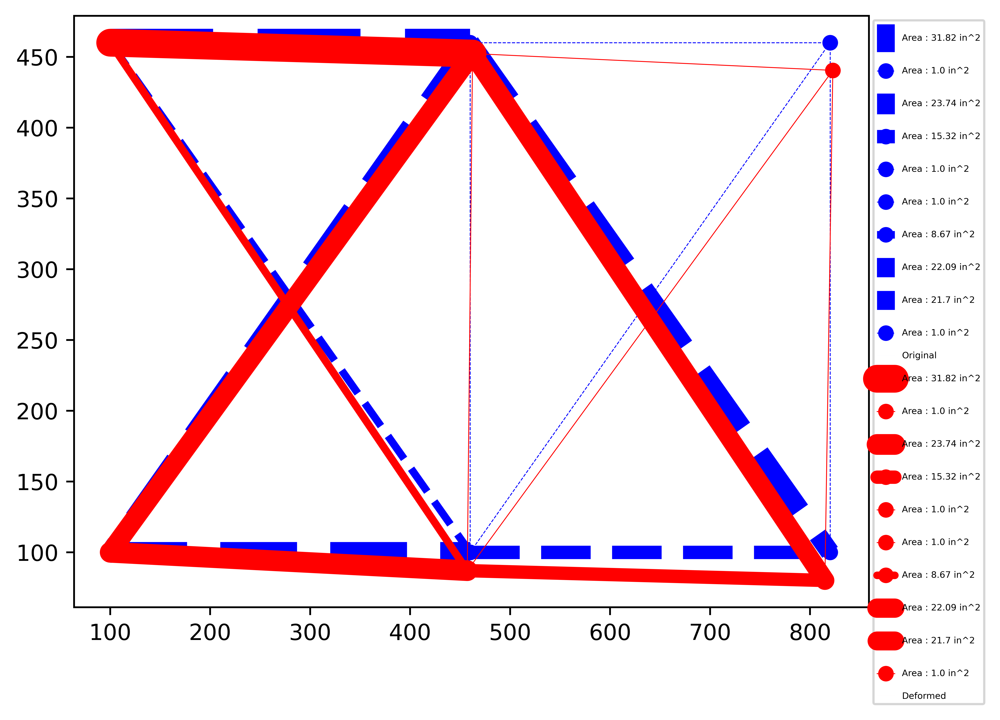

In [ ]:
basic.Plot(nodes, 'b', '--',a, 'Original')
scale = 10
Dnodes=  a_temp[2]*scale + nodes
basic.Plot(Dnodes, 'r', '-',a, 'Deformed')

## GA (size) 
### Changing the area of cross section of the members, treating them as continous values

In [ ]:

#algo
@jax.jit
class solution():
    def ga_solution(Nodes, Bar):

        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss = np.abs(ans[1]) #np.abs(ans[0]).sum()*0.0001 + np.abs(ans[1]) + np.abs(ans[2]).sum()
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -1/loss #"Unstable solution"

        #generate solutions
        solutions, global_best =[], []
        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival)) #
        
        for i in range(250):
            ranked_soln = []

            for s in solutions:
                tt = fitness(np.array(s), Nodes, bars)
                ranked_soln.append((tt,s))

            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])

            if ranked_soln[0][0] > 999:
                print(f'Gen {i} ======== Best Solution')
                break
            else:
                pass

            best_soln = ranked_soln[:1]
            # best_soln = []
            # for _ in range(1000):
            #     best_soln.append(ranked_soln[0])
            global_best.append(ranked_soln[0])

            elements =[]
            for s in best_soln:
                elements.append(s[1][0])
                elements.append(s[1][1])
                elements.append(s[1][2])
                elements.append(s[1][3])
                elements.append(s[1][4])
                elements.append(s[1][5])
                elements.append(s[1][6])
                elements.append(s[1][7])
                elements.append(s[1][8])
                elements.append(s[1][9])

            new_gen = []
            
            for _ in range(1000):

                e1 = elements[0]*np.random.uniform(0.95,1.05) #mutating all solns by 2%
                e2 = elements[1]*np.random.uniform(0.95,1.05)
                e3 = elements[2]*np.random.uniform(0.95,1.05)
                e4 = elements[3]*np.random.uniform(0.95,1.05)
                e5 = elements[4]*np.random.uniform(0.95,1.05)
                e6 = elements[5]*np.random.uniform(0.95,1.05)
                e7 = elements[6]*np.random.uniform(0.95,1.05)
                e8 = elements[7]*np.random.uniform(0.95,1.05)
                e9 = elements[8]*np.random.uniform(0.95,1.05)
                e10 = elements[9]*np.random.uniform(0.95,1.05)

                temp_area = np.array([e1,e2,e3,e4,e5,e6,e7,e8,e9,e10])
                new_gen.append(basic.min_area(temp_area))



            solutions = new_gen
            print(f'The generation {i}, has best solution {ranked_soln[0]}')
            # if i%50==0:
            #     print(f'The generation {i}, has best solution {ranked_soln[0]}')
            # else:
            #     pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])  
        return global_best[0]

solution = jax.jit(solution)

In [ ]:
ga_size = solution.ga_solution(nodes,bars)

The generation 0, has best solution (1.25408359035462e-05, [30.0, 3.87, 30.0, 3.13, 3.84, 11.5, 30.0, 22.9, 15.5, 30.0])
The generation 1, has best solution (1.2972505570685365e-05, array([29.04689347,  3.87904175, 28.64346387,  3.24979807,  3.75442055,
       11.01775546, 28.9990645 , 21.7704121 , 14.98518797, 29.37715682]))
The generation 2, has best solution (1.3218950362903514e-05, array([29.26398505,  4.04897556, 27.76540711,  3.37232884,  3.74214004,
       10.4915556 , 28.37935666, 21.73558192, 14.82984764, 28.00555975]))
The generation 3, has best solution (1.346269025854745e-05, array([28.06767474,  4.16256567, 28.63451864,  3.52741905,  3.86748189,
       10.28706644, 27.76775582, 20.70731965, 14.98351858, 26.89892278]))
The generation 4, has best solution (1.3654502033485638e-05, array([27.86591163,  4.21421467, 29.31251494,  3.6256823 ,  3.71510105,
       10.27955216, 27.28208439, 19.93506884, 15.00661266, 25.75455216]))
The generation 5, has best solution (1.3902587485096

In [ ]:
ga_size

(1.8724607457729672e-05,
 array([32.27181196,  1.        , 23.31830116, 15.36641807,  1.        ,
         1.        ,  7.10830363, 23.232002  , 21.26315076,  1.        ]))

In [ ]:


## Converting the numbers into binary forrmat in python

# bin(ga_size[0])

TypeError: ignored

In [ ]:
area = np.round(ga_size[1], 2)
area

array([32.27,  1.  , 23.32, 15.37,  1.  ,  1.  ,  7.11, 23.23, 21.26,
        1.  ])

In [ ]:
sum(area)

126.56000000000002

In [ ]:
S_size, M_size, U_size, c_size, R_size = Truss.TrussAnalysis(area, nodes, bars)

In [ ]:
size_opt = Truss.TrussAnalysis(area, nodes, bars)

In [ ]:
print(f""" 
The Stress in the various members of the truss is \x1B[3mpsi\x1B[0m : \n{size_opt[0]}\n\n 
The Volume of the the truss is \x1B[3m inch^3 \x1B[0m : {size_opt[1]}\n
The nodal displacements [x & y] in \x1B[3minch\x1B[0m : \n{size_opt[2]}\n\n 
Results for check for stress and deflection limit : {size_opt[3]}\n
The reaction of the supports [x & y] in \x1B[3mpsi\x1B[0m : \n{size_opt[4]} """)

 
The Stress in the various members of the truss is psi : 
[ 6777.24345596   183.93990683 -7774.37194151 -6494.21340879
 18885.58623074   183.93990683 16170.63774505 -7226.40887246
  6639.75662871  -260.13031091]

 
The Volume of the the truss is  inch^3  : 53405.14801709693

The nodal displacements [x & y] in inch : 
[[ 0.          0.        ]
 [ 0.24398076 -0.7642822 ]
 [ 0.2506026  -1.99337268]
 [ 0.          0.        ]
 [-0.27987739 -1.44416331]
 [-0.51366907 -1.99999452]]

 
Results for check for stress and deflection limit : Pass

The reaction of the supports [x & y] in psi : 
[[-300000.          81298.3536761]
 [ 300000.         118701.6463239]] 


In [ ]:
S_size

array([ 6777.24345596,   183.93990683, -7774.37194151, -6494.21340879,
       18885.58623074,   183.93990683, 16170.63774505, -7226.40887246,
        6639.75662871,  -260.13031091])

In [ ]:
M_size

53405.14801709693

In [ ]:
U_size

array([[ 0.        ,  0.        ],
       [ 0.24398076, -0.7642822 ],
       [ 0.2506026 , -1.99337268],
       [ 0.        ,  0.        ],
       [-0.27987739, -1.44416331],
       [-0.51366907, -1.99999452]])

In [ ]:
c_size

'Pass'

In [ ]:
R_size

array([[-300000.       ,   81298.3536761],
       [ 300000.       ,  118701.6463239]])

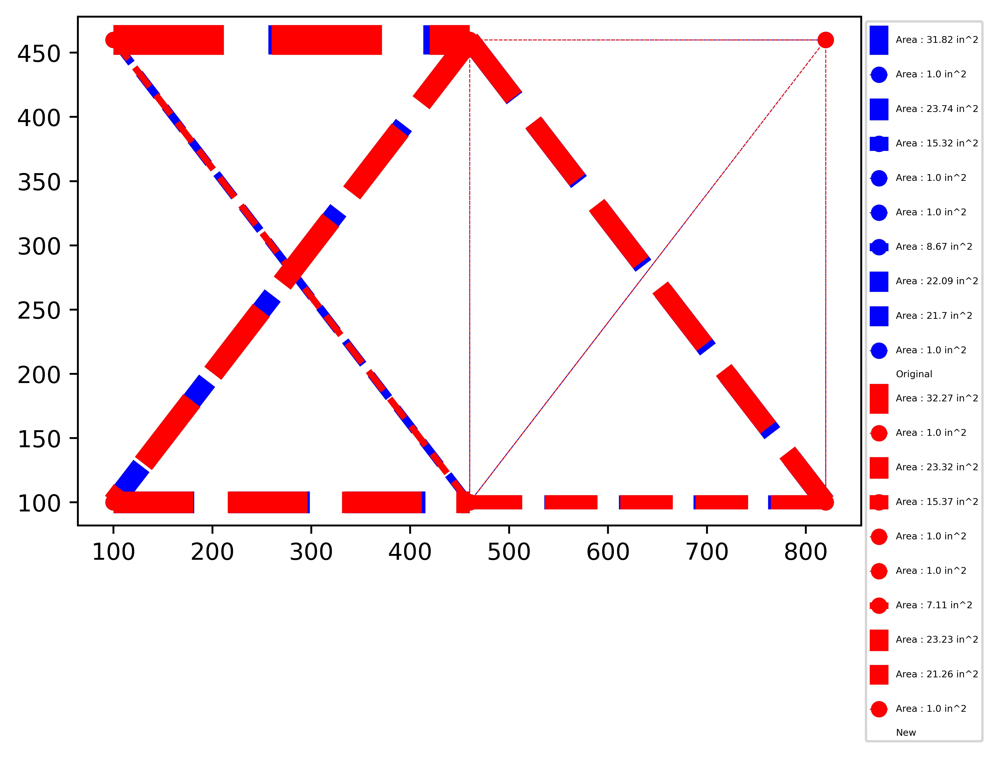

In [ ]:
basic.Plot(nodes, 'b', '--',a, 'Original')
basic.Plot(nodes, 'r', '--',area, 'New')

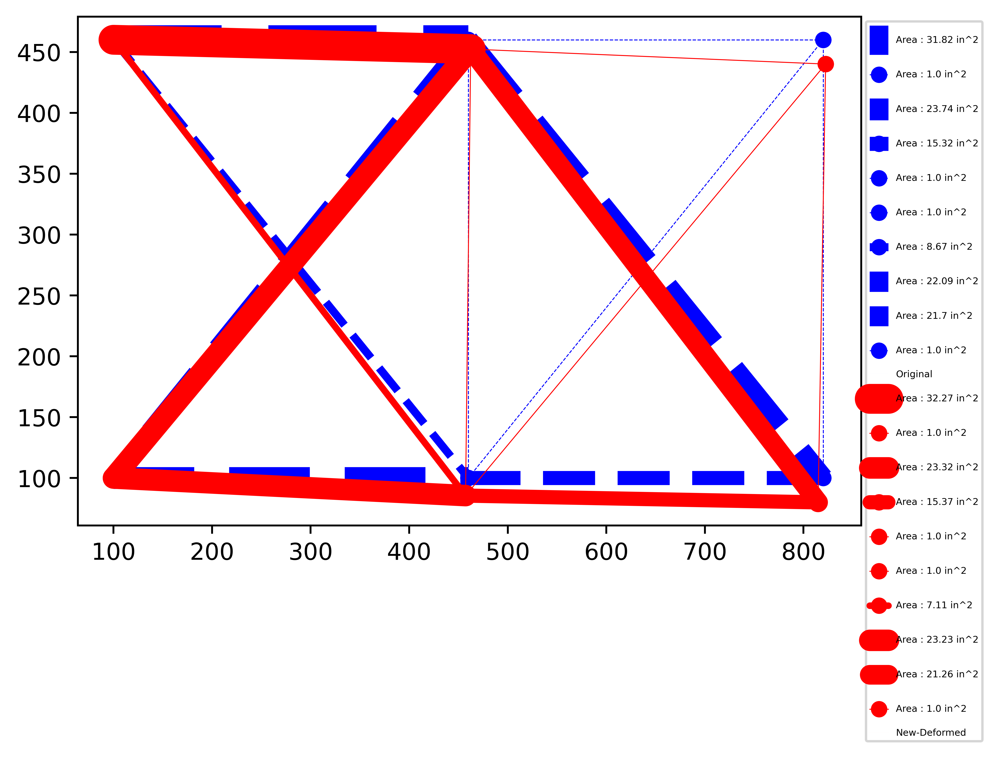

In [ ]:
basic.Plot(nodes, 'b', '--',a, 'Original')
scale = 10
Dnodes=  U_size*scale + nodes
basic.Plot(Dnodes, 'r', '-',area, 'New-Deformed')

## GA (position) { y -dir}
### Treating the areas as discrete values as cited from the litrature and optimizing only the topolgy

In [ ]:
@jax.jit
class position():
    def ga_solution(Nodes, Bar):

        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss =  np.abs(ans[1]) #+ np.abs(ans[2]).sum() +np.abs(ans[0]).sum()*0.0001 +
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -1/loss #"Unstable solution"

        #generate solutions
        solutions, position, global_best = [], [],[]


        for s in range(500):
            solutions.append(litrature) #basic.area_gen(area_avalival))  np.array([30.75,  0.46, 23.2 , 15.  ,  0.06,  0.18,  8.75, 21.06, 20.84,
       # 0.22])

        for p in range(1000):
            position.append(Nodes)
        # optimization_value=[]
        for i in range(250):
            ranked_soln = []
            # print(solutions)
            for s, Nodes in zip(solutions,position):
                # print(s)
                ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

            # print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.sort()
            # ranked_soln.reverse()

            if ranked_soln[0][0] > 999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:1]
            global_best.append(ranked_soln[0])


            elements =[]
            for s in best_soln:
                elements.append(s[1][0])
                elements.append(s[1][1])
                elements.append(s[1][2])
                elements.append(s[1][3])
                elements.append(s[1][4])
                elements.append(s[1][5])
                elements.append(s[1][6])
                elements.append(s[1][7])
                elements.append(s[1][8])
                elements.append(s[1][9])

            new_gen = []
            for _ in range(1000):
                # e1 = np.random.choice(elements)*np.random.uniform(0.95,1.05) #mutating all solns by 5%
                # e2 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                # e3 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                # e4 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                # e5 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                # e6 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                # e7 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                # e8 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                # e9 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                # e10 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e1 = elements[0]*np.random.uniform(0.95,1.05) #mutating all solns by 2%
                e2 = elements[1]*np.random.uniform(0.95,1.05)
                e3 = elements[2]*np.random.uniform(0.95,1.05)
                e4 = elements[3]*np.random.uniform(0.95,1.05)
                e5 = elements[4]*np.random.uniform(0.95,1.05)
                e6 = elements[5]*np.random.uniform(0.95,1.05)
                e7 = elements[6]*np.random.uniform(0.95,1.05)
                e8 = elements[7]*np.random.uniform(0.95,1.05)
                e9 = elements[8]*np.random.uniform(0.95,1.05)
                e10 = elements[9]*np.random.uniform(0.95,1.05)            
                new_gen.append(basic.min_area(np.array([e1,e2,e3,e4,e5,e6,e7,e8,e9,e10])))
            
            solutions = new_gen

            element_x, element_y = [], []
            for ix in range(6):
                    element_x.append(nodes[ix][0])
                    element_y.append(nodes[ix][1])

            new_pos_x, new_pos_y = [], []
            for iy in range(1000):
                xn1 = element_x[0]#*np.random.uniform(0.05,1.95) #mutating all solns by 5% #node0
                xn2 = element_x[1]#*np.random.uniform(0.05,1.95) #node1
                xn3 = element_x[2]#*np.random.uniform(0.05,1.95) #node2
                xn4 = element_x[3]#*np.random.uniform(0.05,1.95) #node3
                # xn5 = element_x*np.random.uniform(0.05,1.95) #node4
                # xn6 = element_x*np.random.uniform(0.05,1.95) #node5
                xn5 = element_x[4]
                xn6 = element_x[5]
                new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

                yn1 = element_y[0]*np.random.uniform(0.05,1.95) #mutating all solns by 5% #node0
                yn2 = element_y[1]*np.random.uniform(0.05,1.95) #node1
                yn3 = element_y[2]*np.random.uniform(0.05,1.95) #node2
                yn4 = element_y[3]#*np.random.uniform(0.05,1.95) #node3
                # yn5 = element_y)*np.random.uniform(0.05,1.95) #node4
                # yn6 = element_y)*np.random.uniform(0.05,1.95) #node5
                yn5 = element_y[4]
                yn6 = element_y[5]
                new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

            # print(new_pos_x[0])
            # print(new_pos_y[0])

            new_pos_star = []
            for iq in range(1000):
                new_pos = []
                for iz in range(6):
                    new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
                new_pos_star.append(np.array(new_pos))
            position = new_pos_star
            # optimization_value.append(ranked_soln[0][0])
            if i%50==0:
                print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
            else:
                pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])  
        return global_best[0]#, optimization_value
        
position = jax.jit(position)

In [ ]:
ga_sol_p = position.ga_solution(nodes, bars)


The generation 0, best solution : 
optimization value : -4.213485700160558e-05
area : [14.09  1.09 10.5   7.87  1.06  1.08  4.43  3.34 12.56  1.05] 
deformations : [[100. 460.]
 [460. 460.]
 [820. 460.]
 [100. 100.]
 [460. 100.]
 [820. 100.]]


The generation 50, best solution : 
optimization value : 3.329336755926777e-05
area : [14.33273079  1.38875275 13.8543507   7.15717545  1.15290751  1.17779956
  5.89367771  2.33631532 11.85988872  1.12184259] 
deformations : [[100.         896.07884253]
 [460.         585.79859281]
 [820.         333.59305827]
 [100.         100.        ]
 [460.         100.        ]
 [820.         100.        ]]


The generation 100, best solution : 
optimization value : 3.229102285022214e-05
area : [15.85123063  1.15173579 13.46025434  7.56536014  1.08076964  1.02633675
  5.71094957  2.9707732  13.89323058  1.03412278] 
deformations : [[100.         825.68675812]
 [460.         600.64454394]
 [820.         185.02026569]
 [100.         100.        ]
 [460.    

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  import sys


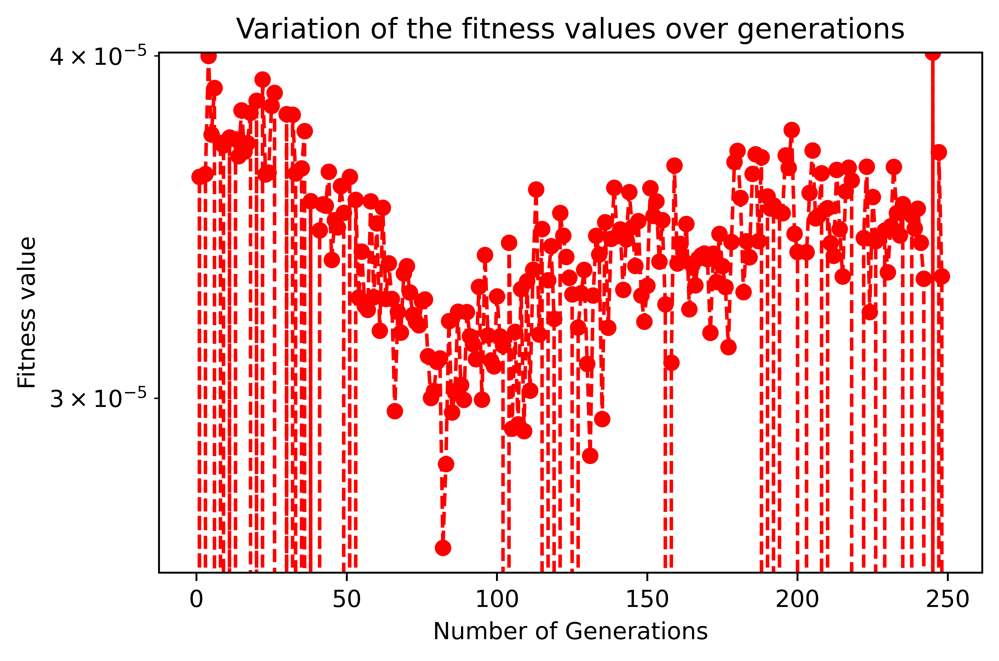

In [ ]:
# plt.rcParams["figure.autolayout"] = True
# plt.yscale("log")
# #plt.xscale("log")
# x = optimization_value
# y = np.linspace(0,249,250)
# plt.plot(y, x, '--or')
# plt.ylim(min(x),max(x))
# plt.title("Variation of the fitness values over generations")
# plt.xlabel("Number of Generations")
# plt.ylabel("Fitness value")
# plt.show()


In [ ]:
ga_sol_p

(3.5402965927619815e-05,
 array([13.928012  ,  1.12809882, 11.78529507,  7.80573551,  1.11272805,
         1.09636216,  4.65059361,  3.28040673, 11.62356566,  1.00014571]),
 array([[100.        , 884.79192026],
        [460.        , 595.89683753],
        [820.        , 148.34992882],
        [100.        , 100.        ],
        [460.        , 100.        ],
        [820.        , 100.        ]]))

In [ ]:
hh = np.round(ga_sol_p[2],2)
hh

array([[100.  , 884.79],
       [460.  , 595.9 ],
       [820.  , 148.35],
       [100.  , 100.  ],
       [460.  , 100.  ],
       [820.  , 100.  ]])

In [ ]:
S_po, M_po, U_po, c_po, R_po = Truss.TrussAnalysis(np.array(ga_sol_p[1]), hh, bars)

In [ ]:
S_po

array([  9323.85922579,   9537.29674906,  -9242.71679041,  -8436.33710348,
        19502.56579727,   8472.67779086,  18737.48084745, -14886.38081037,
         9643.63077001,  -6803.02141943])

In [ ]:
M_po

28246.213051982348

In [ ]:
R_po

array([[-137616.43242141,  160481.88361514],
       [ 137616.43242141,   39518.11638486]])

In [ ]:
U_po

array([[ 0.        ,  0.        ],
       [-0.22292092, -0.96543072],
       [-0.57906127, -1.95492218],
       [ 0.        ,  0.        ],
       [-0.3327378 , -1.93256296],
       [-0.63644594, -1.99588757]])

In [ ]:
c_po

'Pass'

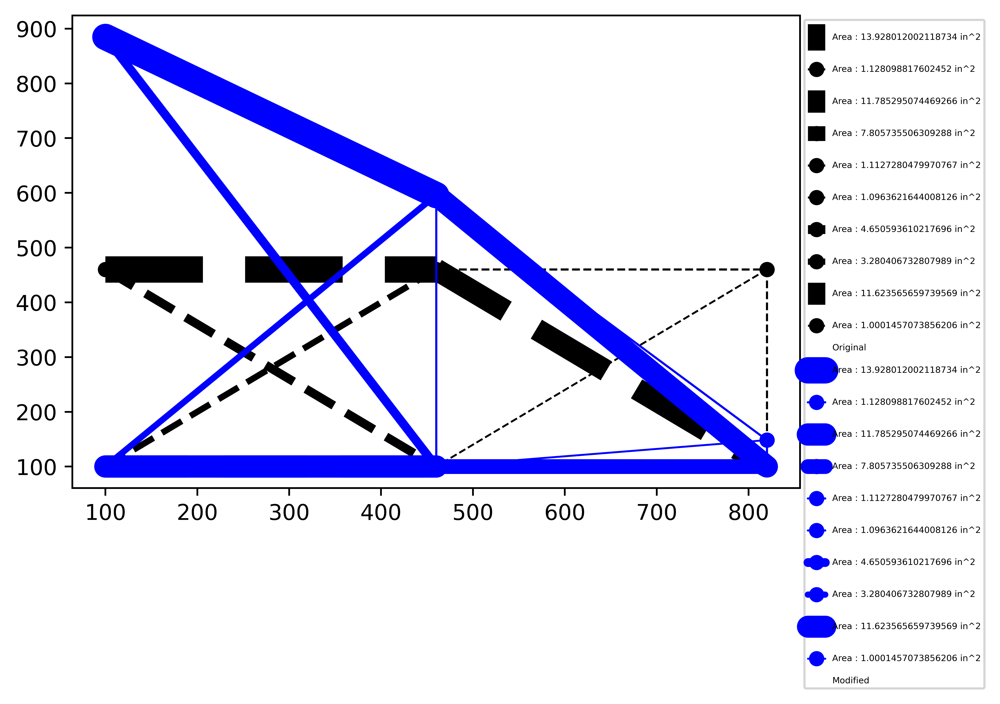

In [ ]:
basic.Plot(nodes, 'black', '--', ga_sol_p[1], 'Original')
basic.Plot(hh, 'b', '-', ga_sol_p[1], 'Modified')

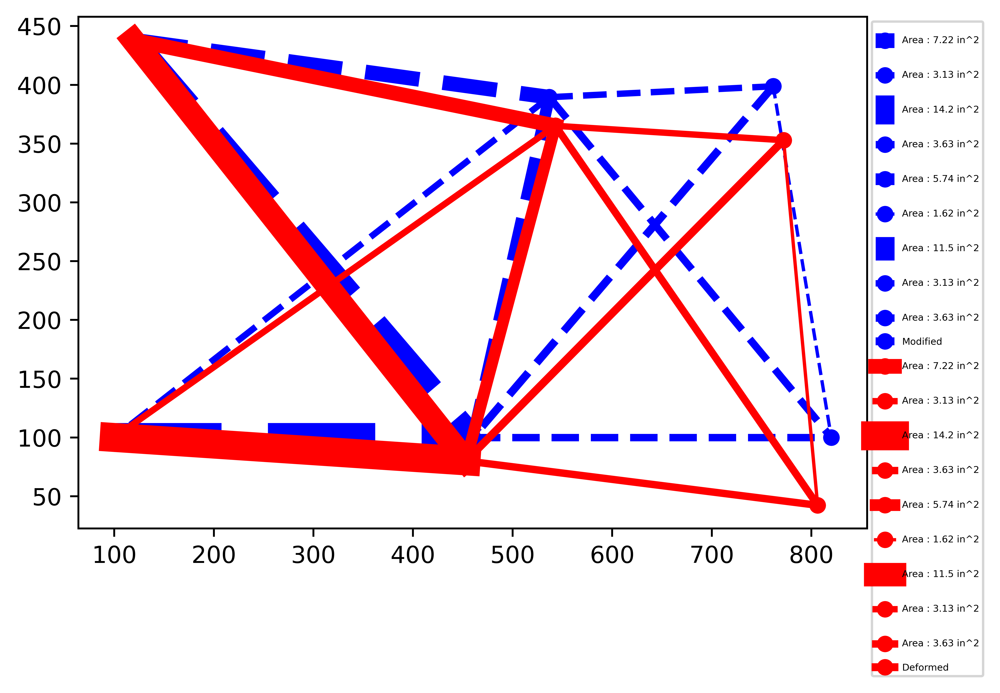

In [ ]:
basic.Plot(hh, 'b', '--',ga_sol_p[1], 'Modified')
scale = 100
Dnodes=  U_po*scale + hh
basic.Plot(Dnodes, 'r', '-',ga_sol_p[1], 'Deformed')

In [ ]:
bars

array([[0, 1],
       [1, 2],
       [3, 4],
       [4, 5],
       [1, 4],
       [2, 5],
       [0, 4],
       [1, 3],
       [1, 5],
       [2, 4]])

In [ ]:
lens = np.array([[2,5],[1,4],[0,3]])

In [ ]:
d = ga_sol_p[2][lens[:,1],:] - ga_sol_p[2][lens[:,0],:]
L = np.sqrt((d**2).sum(axis=1))

In [ ]:
L

array([304.38105201, 299.4729154 , 338.57934295])

## GA (position) {only x -dir}
### Treating the areas as discrete values as cited from the litrature and optimizing only the topolgy

In [ ]:
@jax.jit
class position():
    def ga_solution(Nodes, Bar):

        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss =  np.abs(ans[1]) #+ np.abs(ans[2]).sum() +np.abs(ans[0]).sum()*0.0001 +
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -999 #"Unstable solution"

        #generate solutions
        solutions, position, global_best = [], [],[]


        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival))

        for p in range(1000):
            position.append(Nodes)
        
        for i in range(250):
            ranked_soln = []
            # print(solutions)
            for s, Nodes in zip(solutions,position):
                # print(s)
                ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

            # print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.sort()
            # ranked_soln.reverse()

            if ranked_soln[0][0] > 999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:100]
            global_best.append(ranked_soln[0])

            element_x, element_y = [], []
            for ix in range(6):
                    element_x.append(nodes[ix][0])
                    element_y.append(nodes[ix][1])

            new_pos_x, new_pos_y = [], []
            for iy in range(1000):
                xn1 = element_x[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                xn2 = element_x[1]#*np.random.uniform(0.80,1.20) #node1
                xn3 = element_x[2]*np.random.uniform(0.80,1.20) #node2
                xn4 = element_x[3]*np.random.uniform(0.80,1.20) #node3
                # xn5 = element_x*np.random.uniform(0.80,1.20) #node4
                # xn6 = element_x*np.random.uniform(0.80,1.20) #node5
                xn5 = element_x[4]
                xn6 = element_x[5]
                new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

                yn1 = element_y[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                yn2 = element_y[1]#*np.random.uniform(0.80,1.20) #node1
                yn3 = element_y[2]#*np.random.uniform(0.80,1.20) #node2
                yn4 = element_y[3]#*np.random.uniform(0.80,1.20) #node3
                # yn5 = element_y)*np.random.uniform(0.80,1.20) #node4
                # yn6 = element_y)*np.random.uniform(0.80,1.20) #node5
                yn5 = element_y[4]
                yn6 = element_y[5]
                new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

            # print(new_pos_x[0])
            # print(new_pos_y[0])

            new_pos_star = []
            for iq in range(1000):
                new_pos = []
                for iz in range(6):
                    new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
                new_pos_star.append(np.array(new_pos))
            position = new_pos_star
            if i%50==0:
                print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
            else:
                pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])  
        return global_best[0]
        
position = jax.jit(position)

In [ ]:
ga_sol_p = position.ga_solution(nodes, bars)


The generation 0, best solution : 
optimization value : 0.001069483667579201
area : [2.62, 5.12, 1.8, 4.49, 18.8, 13.5, 7.22, 2.38, 14.2, 13.9] 
deformations : [[300. 200.]
 [300. 100.]
 [200. 200.]
 [200. 100.]
 [100. 200.]
 [100. 100.]]


The generation 50, best solution : 
optimization value : 0.0011308970115100861
area : [3.87, 3.38, 4.8, 4.8, 7.97, 2.62, 14.2, 11.5, 7.97, 22.9] 
deformations : [[300.         200.        ]
 [300.         100.        ]
 [182.74359807 200.        ]
 [169.25434342 100.        ]
 [100.         200.        ]
 [100.         100.        ]]


The generation 100, best solution : 
optimization value : 0.0010995629816546936
area : [3.87, 3.38, 4.8, 4.8, 7.97, 2.62, 14.2, 11.5, 7.97, 22.9] 
deformations : [[300.         200.        ]
 [300.         100.        ]
 [171.71393911 200.        ]
 [194.02897518 100.        ]
 [100.         200.        ]
 [100.         100.        ]]


The generation 150, best solution : 
optimization value : 0.0011234675245562265
a

In [ ]:
ga_sol_p

(0.001188553542520782,
 [3.87, 3.38, 4.8, 4.8, 7.97, 2.62, 14.2, 11.5, 7.97, 22.9],
 array([[300.        , 200.        ],
        [300.        , 100.        ],
        [160.84563621, 200.        ],
        [161.08787442, 100.        ],
        [100.        , 200.        ],
        [100.        , 100.        ]]))

In [ ]:
hh = np.round(ga_sol_p[2],2)
hh

array([[300.  , 200.  ],
       [300.  , 100.  ],
       [160.85, 200.  ],
       [161.09, 100.  ],
       [100.  , 200.  ],
       [100.  , 100.  ]])

In [ ]:
S_po, M_po, U_po, c_po, R_po = Truss.TrussAnalysis(np.array(ga_sol_p[1]), hh, bars)

In [ ]:
S_po

array([  9602.90113224,  15273.20685089, -13251.84234394,  22432.14450546,
       -10970.81168109,   9125.1080685 ,  13514.23993306,  -8829.73101264,
        16652.05128512,  -9096.3309921 ])

In [ ]:
M_po

841.3676713729826

In [ ]:
R_po

array([[-261090.        ,  113255.51309642],
       [ 261090.        ,   86744.48690358]])

In [ ]:
U_po

array([[ 0.02947608, -0.11374828],
       [-0.0207965 , -0.12335118],
       [ 0.00822341, -0.01710308],
       [-0.00555695, -0.02626132],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ]])

In [ ]:
c_po

'Pass'

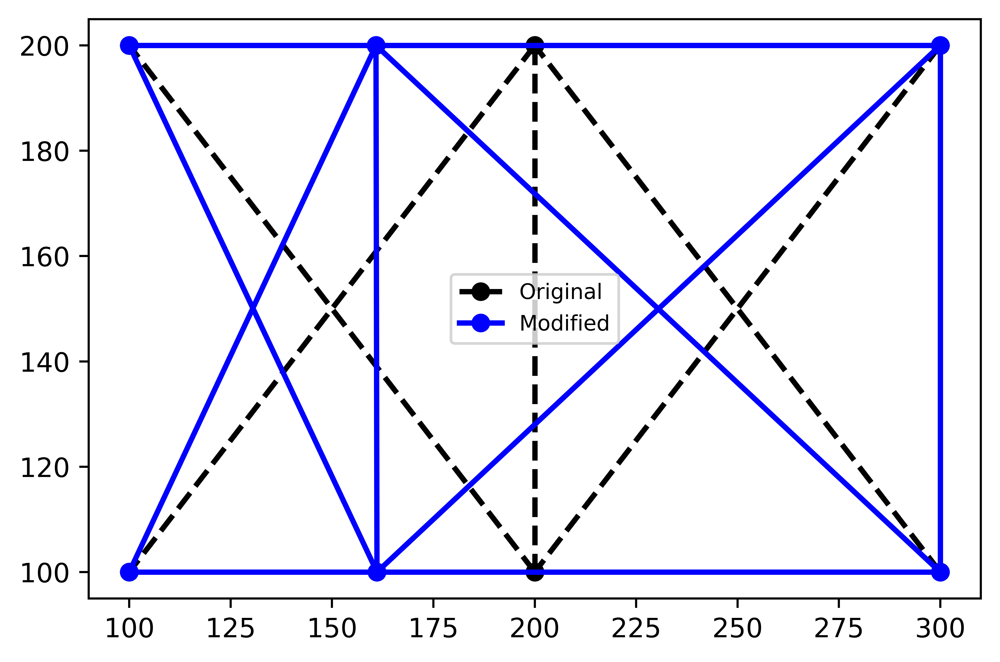

In [ ]:
basic.Plot(nodes, 'black', '--',2, 'Original')
basic.Plot(hh, 'b', '-',2, 'Modified')

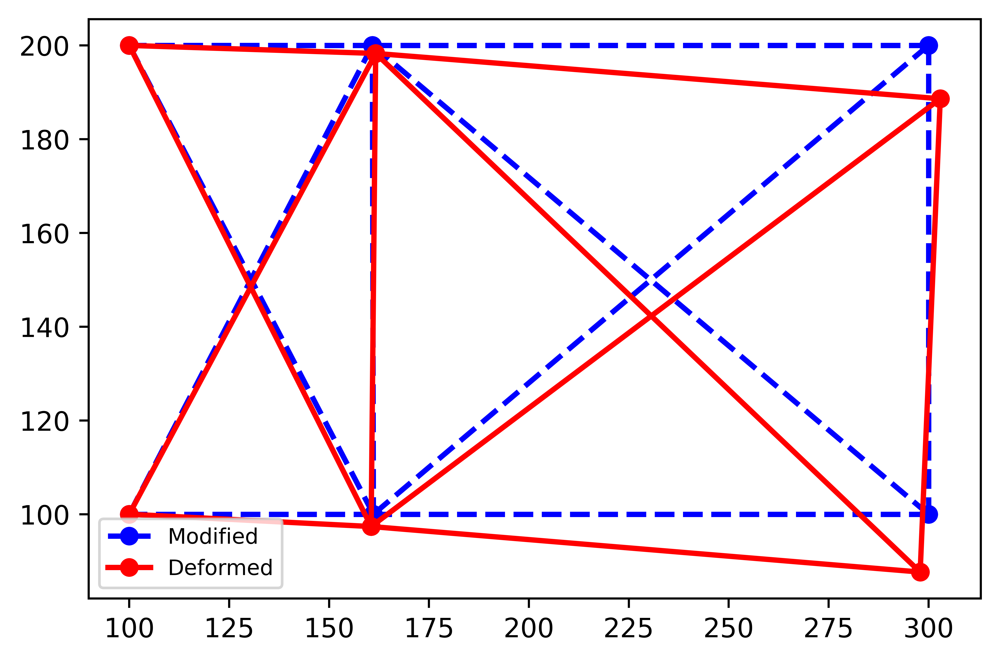

In [ ]:
basic.Plot(hh, 'b', '--',2, 'Modified')
scale = 100
Dnodes=  U_po*scale + hh
basic.Plot(Dnodes, 'r', '-',2, 'Deformed')

## GA (position) {only y -dir}
### Treating the areas as discrete values as cited from the litrature and optimizing only the topolgy

In [ ]:
@jax.jit
class position():
    def ga_solution(Nodes, Bar):

        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss =  np.abs(ans[1]) #+ np.abs(ans[2]).sum() +np.abs(ans[0]).sum()*0.0001 +
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -999 #"Unstable solution"

        #generate solutions
        solutions, position, global_best = [], [],[]


        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival))

        for p in range(1000):
            position.append(Nodes)
        
        for i in range(250):
            ranked_soln = []
            # print(solutions)
            for s, Nodes in zip(solutions,position):
                # print(s)
                ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

            # print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.sort()
            # ranked_soln.reverse()

            if ranked_soln[0][0] > 999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:100]
            global_best.append(ranked_soln[0])

            element_x, element_y = [], []
            for ix in range(6):
                    element_x.append(nodes[ix][0])
                    element_y.append(nodes[ix][1])

            new_pos_x, new_pos_y = [], []
            for iy in range(1000):
                xn1 = element_x[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                xn2 = element_x[1]#*np.random.uniform(0.80,1.20) #node1
                xn3 = element_x[2]#*np.random.uniform(0.80,1.20) #node2
                xn4 = element_x[3]#*np.random.uniform(0.80,1.20) #node3
                # xn5 = element_x*np.random.uniform(0.80,1.20) #node4
                # xn6 = element_x*np.random.uniform(0.80,1.20) #node5
                xn5 = element_x[4]
                xn6 = element_x[5]
                new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

                yn1 = element_y[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                yn2 = element_y[1]#*np.random.uniform(0.80,1.20) #node1
                yn3 = element_y[2]*np.random.uniform(0.80,1.20) #node2
                yn4 = element_y[3]*np.random.uniform(0.80,1.20) #node3
                # yn5 = element_y)*np.random.uniform(0.80,1.20) #node4
                # yn6 = element_y)*np.random.uniform(0.80,1.20) #node5
                yn5 = element_y[4]
                yn6 = element_y[5]
                new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

            # print(new_pos_x[0])
            # print(new_pos_y[0])

            new_pos_star = []
            for iq in range(1000):
                new_pos = []
                for iz in range(6):
                    new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
                new_pos_star.append(np.array(new_pos))
            position = new_pos_star
            if i%50==0:
                print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
            else:
                pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])  
        return global_best[0]
        
position = jax.jit(position)

In [ ]:
ga_sol_p = position.ga_solution(nodes, bars)


The generation 0, best solution : 
optimization value : 0.0013259808819188485
area : [3.38, 4.18, 3.63, 3.13, 7.22, 1.62, 5.74, 2.88, 19.9, 11.5] 
deformations : [[300. 200.]
 [300. 100.]
 [200. 200.]
 [200. 100.]
 [100. 200.]
 [100. 100.]]


The generation 50, best solution : 
optimization value : 0.001035585650929412
area : [2.38, 5.74, 4.18, 5.74, 13.9, 3.09, 18.8, 2.38, 18.8, 11.5] 
deformations : [[300.         200.        ]
 [300.         100.        ]
 [200.         190.28366208]
 [200.         112.15562174]
 [100.         200.        ]
 [100.         100.        ]]


The generation 100, best solution : 
optimization value : 0.0011067366191052958
area : [1.62, 3.87, 4.18, 3.38, 3.84, 3.84, 18.8, 16.0, 4.97, 13.9] 
deformations : [[300.         200.        ]
 [300.         100.        ]
 [200.         210.01644335]
 [200.          81.67195347]
 [100.         200.        ]
 [100.         100.        ]]


The generation 150, best solution : 
optimization value : 0.0011819675123984

In [ ]:
ga_sol_p

(0.0013691909556329334,
 [3.38, 4.18, 3.63, 3.13, 7.22, 1.62, 5.74, 2.88, 19.9, 11.5],
 array([[300.        , 200.        ],
        [300.        , 100.        ],
        [200.        , 209.421055  ],
        [200.        , 119.13361489],
        [100.        , 200.        ],
        [100.        , 100.        ]]))

In [ ]:
hh = np.round(ga_sol_p[2],2)
hh

array([[300.  , 200.  ],
       [300.  , 100.  ],
       [200.  , 209.42],
       [200.  , 119.13],
       [100.  , 200.  ],
       [100.  , 100.  ]])

In [ ]:
S_po, M_po, U_po, c_po, R_po = Truss.TrussAnalysis(np.array(ga_sol_p[1]), hh, bars)

In [ ]:
S_po

array([ 17790.49699949,  16003.21477095, -23595.31012074,  20911.43520539,
        -6226.63784779, -20857.40526619,  24845.91449787, -16075.31834101,
        10211.91077349, -23794.86434391])

In [ ]:
M_po

730.3622409283006

In [ ]:
R_po

array([[-300000.        ,  114409.96482632],
       [ 300000.        ,   85590.03517368]])

In [ ]:
U_po

array([[ 0.03778033, -0.15720201],
       [-0.04869686, -0.17499251],
       [ 0.03075496, -0.06038826],
       [-0.01671597, -0.04155611],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ]])

In [ ]:
c_po

'Pass'

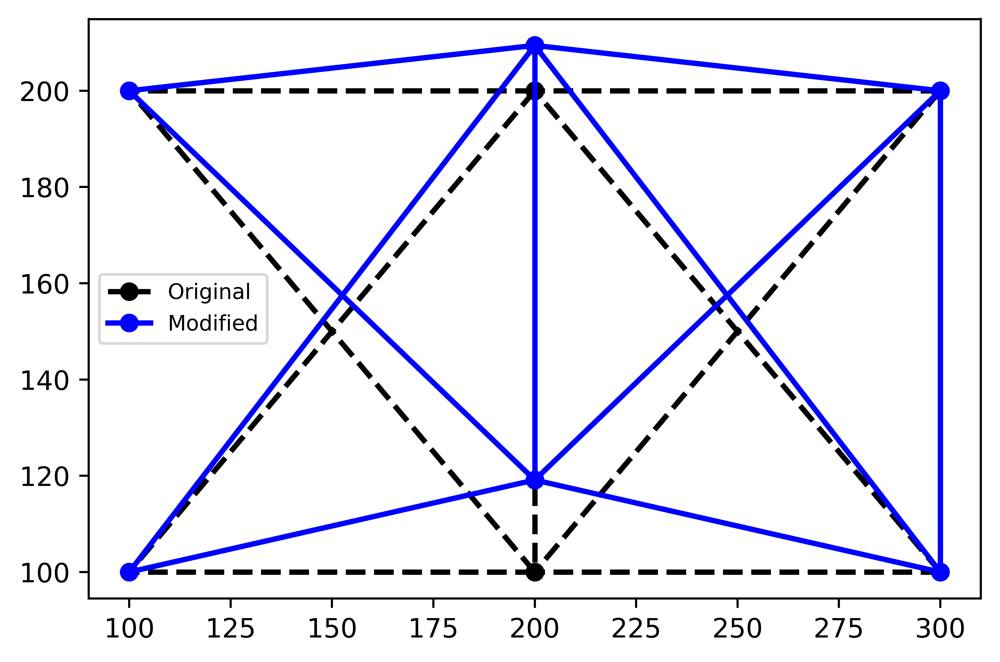

In [ ]:
basic.Plot(nodes, 'black', '--',2, 'Original')
basic.Plot(hh, 'b', '-',2, 'Modified')

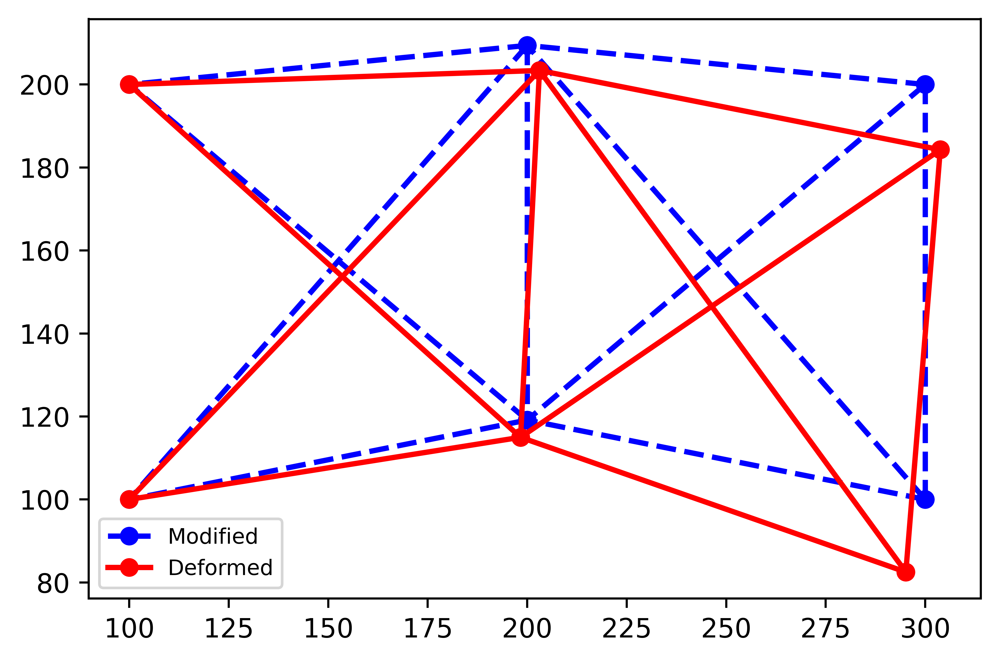

In [ ]:
basic.Plot(hh, 'b', '--',2, 'Modified')
scale = 100
Dnodes=  U_po*scale + hh
basic.Plot(Dnodes, 'r', '-',2, 'Deformed')

## GA (size + topology)
### optimizing for both shape size and topology treating the area as continous

In [ ]:
#algo
@jax.jit
class sol_1():
    def ga_solution(Nodes, Bar):
        # loss_list = []
        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss =  np.abs(ans[1]) #+ np.abs(ans[2]).sum() np.abs(ans[0]).sum()*0.0001 +
            # loss_list.append(loss)
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -999 #"Unstable solution"

        #generate solutions
        solutions, position, global_best = [], [], []


        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival))

        for p in range(1000):
            position.append(Nodes)
        
        for i in range(1000):
            ranked_soln = []
            # print(solutions)
            for s, Nodes in zip(solutions,position):
                # print(s)
                ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

            # print(ranked_soln)
            # ranked_soln = sorted(ranked_soln, reverse=True)
            #print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.reverse()

            if ranked_soln[0][0] >999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:1]
            global_best.append(ranked_soln[0])
            elements =[]
            for s in best_soln:
                elements.append(s[1][0])
                elements.append(s[1][1])
                elements.append(s[1][2])
                elements.append(s[1][3])
                elements.append(s[1][4])
                elements.append(s[1][5])
                elements.append(s[1][6])
                elements.append(s[1][7])
                elements.append(s[1][8])
                elements.append(s[1][9])

            new_gen = []
            for _ in range(1000):
                e1 = elements[0]*np.random.uniform(0.95,1.05) #mutating all solns by 2%
                e2 = elements[1]*np.random.uniform(0.95,1.05)
                e3 = elements[2]*np.random.uniform(0.95,1.05)
                e4 = elements[3]*np.random.uniform(0.95,1.05)
                e5 = elements[4]*np.random.uniform(0.95,1.05)
                e6 = elements[5]*np.random.uniform(0.95,1.05)
                e7 = elements[6]*np.random.uniform(0.95,1.05)
                e8 = elements[7]*np.random.uniform(0.95,1.05)
                e9 = elements[8]*np.random.uniform(0.95,1.05)
                e10 = elements[9]*np.random.uniform(0.95,1.05)

                new_gen.append(np.array([e1,e2,e3,e4,e5,e6,e7,e8,e9,e10]))
            
            solutions = new_gen

            element_x, element_y =[], []
            for ix in range(6):
                    element_x.append(nodes[ix][0])
                    element_y.append(nodes[ix][1])

            new_pos_x, new_pos_y = [], []
            for iy in range(1000):
                xn1 = element_x[0]*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                xn2 = element_x[1]*np.random.uniform(0.80,1.20) #node1
                xn3 = element_x[2]*np.random.uniform(0.80,1.20) #node2
                xn4 = element_x[3]#*np.random.uniform(0.80,1.20) #node3
                # xn5 = element_x*np.random.uniform(0.80,1.20) #node4
                # xn6 = element_x*np.random.uniform(0.80,1.20) #node5
                xn5 = element_x[4]
                xn6 = element_x[5]
                new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

                yn1 = element_y[0]*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                yn2 = element_y[1]*np.random.uniform(0.80,1.20) #node1
                yn3 = element_y[2]*np.random.uniform(0.80,1.20) #node2
                yn4 = element_y[3]#*np.random.uniform(0.80,1.20) #node3
                yn5 = element_y[4]
                yn6 = element_y[5]
                new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

            # print(new_pos_x[0])
            # print(new_pos_y[0])

            new_pos_star = []
            for iq in range(1000):
                new_pos = []
                for iz in range(6):
                    new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
                new_pos_star.append(np.array(new_pos))
            position = new_pos_star
            if i%50==0:
                print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
            else:
                pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])   
        #plt.plot(loss_list)
        return global_best[0]

In [ ]:
ga_sol = sol_1.ga_solution(nodes, bars)


The generation 0, best solution : 
optimization value : 1.2762088557176087e-05
area : [30.0, 30.0, 22.0, 16.0, 4.49, 2.88, 13.9, 22.0, 30.0, 13.5] 
deformations : [[100. 460.]
 [460. 460.]
 [820. 460.]
 [100. 100.]
 [460. 100.]
 [820. 100.]]


The generation 50, best solution : 
optimization value : 1.809199340426717e-05
area : [18.12060227 29.06349352 15.71582454 13.33034818  5.87697827  3.2215313
 10.8904469  14.83118641 22.24145921  8.60688486] 
deformations : [[ 81.4950325  543.87775558]
 [548.23821181 476.87713784]
 [676.50573594 395.75138642]
 [100.         100.        ]
 [460.         100.        ]
 [820.         100.        ]]


The generation 100, best solution : 
optimization value : 1.9806453493056715e-05
area : [19.15345415 23.34337009 16.81209637 14.80104014  4.31689512  3.41957857
  9.74715171  9.48202417 23.51383736  8.26283925] 
deformations : [[112.47328464 546.45582529]
 [497.32408765 422.46916665]
 [684.599344   427.72246968]
 [100.         100.        ]
 [460.     

KeyboardInterrupt: ignored

In [ ]:
ga_sol

(2.137864326437597e-05,
 array([28.71236524,  0.5255845 , 19.71616501, 14.35934844,  0.10919919,
         1.5236571 ,  8.23518308, 17.07076783, 19.84941471,  0.58095458]),
 array([[104.83946103, 481.01452959],
        [482.19115401, 440.70968006],
        [804.07169748, 466.88083692],
        [100.        , 100.        ],
        [460.        , 100.        ],
        [820.        , 100.        ]]))

In [ ]:
a = np.round(ga_sol[1],2)
d = np.round(ga_sol[2],2)
a, d

(array([28.71,  0.53, 19.72, 14.36,  0.11,  1.52,  8.24, 17.07, 19.85,
         0.58]), array([[104.84, 481.01],
        [482.19, 440.71],
        [804.07, 466.88],
        [100.  , 100.  ],
        [460.  , 100.  ],
        [820.  , 100.  ]]))

In [ ]:
S, M, U, c, R = Truss.TrussAnalysis(a, d, bars)

In [ ]:
S

array([ 6702.48019601,  -690.82914768, -9614.10366592, -6927.19686194,
       21941.380263  ,  -226.23399003, 16129.29031784, -7249.47597339,
        7118.61820218,   882.1923234 ])

In [ ]:
M

46778.557179541116

In [ ]:
R

array([[-281962.57235607,  117652.95591211],
       [ 281962.57235607,   82347.04408789]])

In [ ]:
U

array([[ 0.        ,  0.        ],
       [ 0.17523814, -0.75436908],
       [ 0.2517734 , -1.97102707],
       [ 0.        ,  0.        ],
       [-0.34610773, -1.47115025],
       [-0.59548682, -1.99949956]])

In [ ]:
c

'Pass'

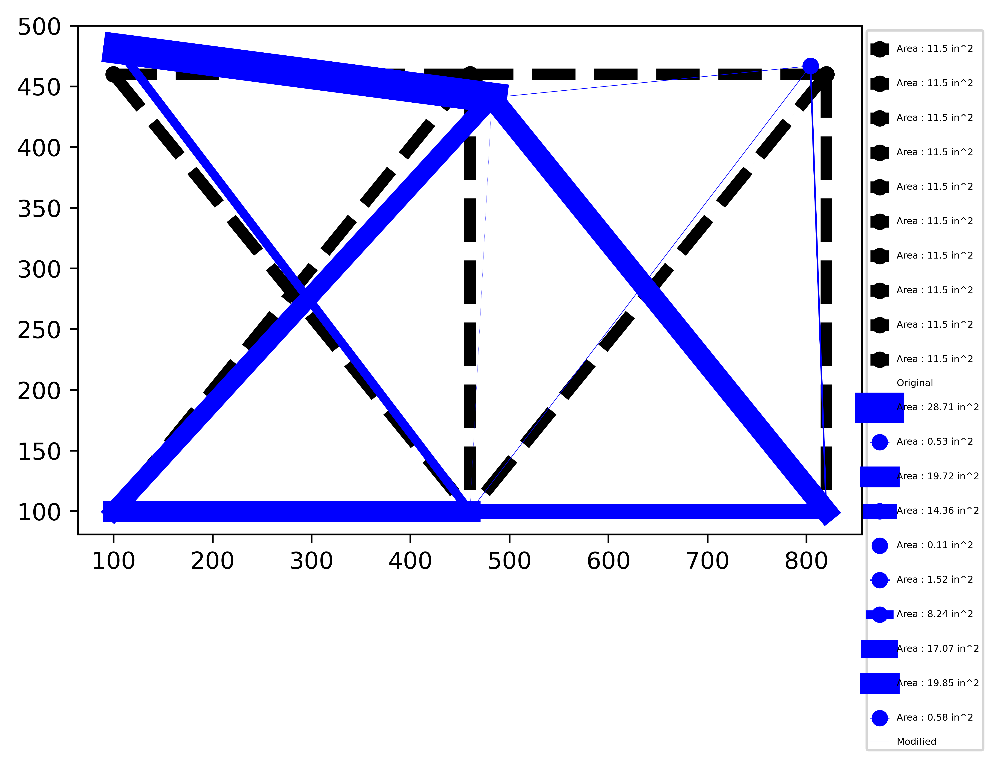

In [ ]:
basic.Plot(nodes, 'black', '--',[11.5]*10, 'Original')
basic.Plot(d, 'b', '-',a, 'Modified')
# scale = 100
# Dnodes=  U*scale + ga_sol[2]
# Plot(Dnodes, 'g', '-',1, 'Deformed')

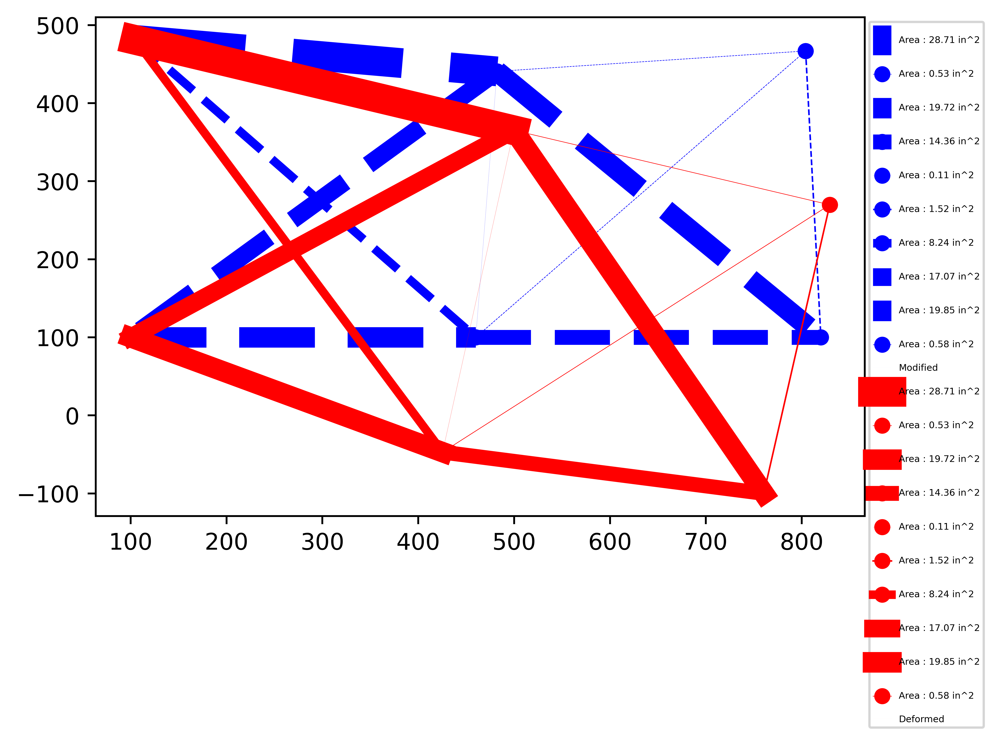

In [ ]:
basic.Plot(d, 'b', '--',a, 'Modified')
scale = 10
Dnodes=  U*scale + d
basic.Plot(Dnodes, 'r', '-',a, 'Deformed')

## GA (size + topology) 

In [ ]:
litrature = np.array([14.09, 1.09, 10.5, 7.87, 1.06, 1.08, 4.43, 3.34, 12.56, 1.05])
new_nodes = np.array([[100, 893.5],
                        [460, 572.7],
                        [820,198.1],
                        [100,100],
                        [460,100],
                        [820,100]])

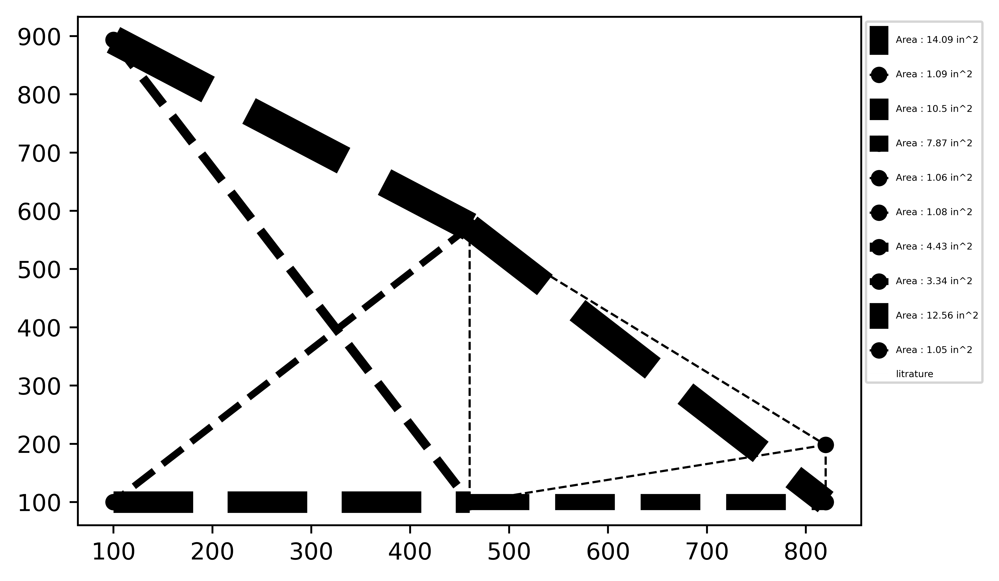

In [ ]:
basic.Plot(new_nodes, 'black', '--',litrature, 'litrature')

In [ ]:
litrature_analysis = Truss.TrussAnalysis(litrature, new_nodes, bars)

In [ ]:
print(f""" 
The Stress in the various members of the truss is \x1B[3mpsi\x1B[0m : \n{litrature_analysis[0]}\n\n 
The Volume of the the truss is \x1B[3m inch^3 \x1B[0m : {litrature_analysis[1]}\n
The nodal displacements [x & y] in \x1B[3minch\x1B[0m : \n{litrature_analysis[2]}\n\n 
Results for check for stress and deflection limit : {litrature_analysis[3]}\n
The reaction of the supports [x & y] in \x1B[3mpsi\x1B[0m : \n{litrature_analysis[4]} """)

 
The Stress in the various members of the truss is psi : 
[  9654.72929888   7918.1819373  -10543.07792114  -8917.12892838
  24046.00258448   7270.96639463  18873.72252175 -12553.37540968
   9221.95182351  -5903.3351052 ]

 
The Volume of the the truss is  inch^3  : 28279.891287917493

The nodal displacements [x & y] in inch : 
[[ 0.          0.        ]
 [-0.1262402  -0.84143121]
 [-0.63014929 -1.89626016]
 [ 0.          0.        ]
 [-0.37955081 -1.97808575]
 [-0.70056745 -1.96758834]]

 
Results for check for stress and deflection limit : Pass

The reaction of the supports [x & y] in psi : 
[[-136105.86011342  166643.73812299]
 [ 136105.86011342   33356.26187701]] 


In [ ]:
#algo
def ga_solution(Nodes, Bar):
    # loss_list = []
    def fitness(Area, Nodes, Bar):
        ans = Truss.TrussAnalysis(Area, Nodes, Bar)
        
        loss =np.abs(ans[1]) #np.abs(ans[0]).sum()*0.0001 + np.abs(ans[1]) + np.abs(ans[2]).sum()
        # loss_list.append(loss)
        # print(ans)
        #sum = ans.sum(axis=1)
        if ans[3]=='Pass':
            if loss == 0 :
                return 99999
            else:
                return abs(1/loss)
        else:
            return -1/loss #"Unstable solution"

    #generate solutions
    solutions, position, global_best = [], [], []


    for s in range(1000):
        solutions.append(litrature) #basic.area_gen(area_avalival)

    for p in range(1000):
        position.append(Nodes)

    # optimization_value=[]
    for i in range(1000):
        ranked_soln = []
        # print(solutions)
        for s, Nodes in zip(solutions,position):
            # print(s)
            ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

        # print(ranked_soln)
        # ranked_soln = sorted(ranked_soln, reverse=True)
        #print(ranked_soln)
        ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
        # ranked_soln.reverse()

        if ranked_soln[0][0] >999:
            print(f'Gen {i} ======== Best Solution')
            #print(ranked_soln[0])
            break
        best_soln = ranked_soln[:1]
        global_best.append(ranked_soln[0])

        elements =[]
        for s in best_soln:
            elements.append(s[1][0])
            elements.append(s[1][1])
            elements.append(s[1][2])
            elements.append(s[1][3])
            elements.append(s[1][4])
            elements.append(s[1][5])
            elements.append(s[1][6])
            elements.append(s[1][7])
            elements.append(s[1][8])
            elements.append(s[1][9])

        new_gen = []
        for _ in range(1000):
            # e1 = np.random.choice(elements)*np.random.uniform(0.95,1.05) #mutating all solns by 5%
            # e2 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            # e3 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            # e4 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            # e5 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            # e6 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            # e7 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            # e8 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            # e9 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            # e10 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e1 = elements[0]*np.random.uniform(0.95,1.05) #mutating all solns by 2%
            e2 = elements[1]*np.random.uniform(0.95,1.05)
            e3 = elements[2]*np.random.uniform(0.95,1.05)
            e4 = elements[3]*np.random.uniform(0.95,1.05)
            e5 = elements[4]*np.random.uniform(0.95,1.05)
            e6 = elements[5]*np.random.uniform(0.95,1.05)
            e7 = elements[6]*np.random.uniform(0.95,1.05)
            e8 = elements[7]*np.random.uniform(0.95,1.05)
            e9 = elements[8]*np.random.uniform(0.95,1.05)
            e10 = elements[9]*np.random.uniform(0.95,1.05)            
            new_gen.append(basic.min_area(np.array([e1,e2,e3,e4,e5,e6,e7,e8,e9,e10])))
        
        solutions = new_gen

        element_x, element_y =[], []
        for ix in range(6):
                element_x.append(nodes[ix][0])
                element_y.append(nodes[ix][1])

        new_pos_x, new_pos_y = [], []
        for iy in range(1000):
            xn1 = element_x[0]#*np.random.uniform(0.95,1.05) #mutating all solns by 5% #node0
            xn2 = element_x[1]#*np.random.uniform(0.95,1.05) #node1
            xn3 = element_x[2]#*np.random.uniform(0.95,1.05) #node2
            xn4 = element_x[3]#*np.random.uniform(0.95,1.05) #node3
            xn5 = element_x[4]
            xn6 = element_x[5]
            new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

            yn1 = element_y[0]*np.random.uniform(0.05,2.05) #mutating all solns by 5% #node0
            yn2 = element_y[1]*np.random.uniform(0.05,2.05) #node1
            yn3 = element_y[2]*np.random.uniform(0.05,2.05) #node2
            yn4 = element_y[3]#*np.random.uniform(0.95,1.05) #node3
            yn5 = element_y[4]
            yn6 = element_y[5]
            new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

        # print(new_pos_x[0])
        # print(new_pos_y[0])

        new_pos_star = []
        for iq in range(1000):
            new_pos = []
            for iz in range(6):
                new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
            new_pos_star.append(np.array(new_pos))
        position = new_pos_star

        # optimization_value.append(ranked_soln[0][0])
        if i % 50 ==0:
            print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
        else:
            pass
    
    global_best.sort(reverse = True, key=lambda soln: soln[0])
    #plt.plot(loss_list)
    return global_best[0]

In [ ]:
ga_sol_const_base = ga_solution(nodes, bars)


The generation 0, best solution : 
optimization value : -4.213485700160558e-05
area : [14.09  1.09 10.5   7.87  1.06  1.08  4.43  3.34 12.56  1.05] 
deformations : [[100. 460.]
 [460. 460.]
 [820. 460.]
 [100. 100.]
 [460. 100.]
 [820. 100.]]


The generation 50, best solution : 
optimization value : -2.2890099873334418e-05
area : [22.53674961  1.47610564  8.52254888  7.81858589  1.16114913  1.10400261
  4.2541147   3.04798889 11.18756706  1.23406693] 
deformations : [[100.          96.20452035]
 [460.         932.84430093]
 [820.         405.99063149]
 [100.         100.        ]
 [460.         100.        ]
 [820.         100.        ]]


The generation 100, best solution : 
optimization value : 3.4256790523164804e-05
area : [16.33990061  1.72381678 11.44617148  7.80781249  1.11097637  1.38711222
  4.48646326  2.65291376 11.8258184   1.33792347] 
deformations : [[100.         875.49175763]
 [460.         574.30248415]
 [820.          65.50345904]
 [100.         100.        ]
 [460. 

In [ ]:
ga_sol_const_base

(3.54963091026527e-05,
 array([15.2842141 ,  1.03751462,  9.81373458,  8.02138294,  1.00814378,
         1.15314642,  4.38580021,  3.2250569 , 12.34752796,  1.0725543 ]),
 array([[100.        , 880.20472829],
        [460.        , 570.99947821],
        [820.        ,  89.14996979],
        [100.        , 100.        ],
        [460.        , 100.        ],
        [820.        , 100.        ]]))

In [ ]:
a = np.round(ga_sol_const_base[1],2)
d = np.round(ga_sol_const_base[2],2)
a,d

(array([15.28,  1.04,  9.81,  8.02,  1.01,  1.15,  4.39,  3.23, 12.35,
         1.07]), array([[100.  , 880.2 ],
        [460.  , 571.  ],
        [820.  ,  89.15],
        [100.  , 100.  ],
        [460.  , 100.  ],
        [820.  , 100.  ]]))

In [ ]:
S_const, M_const, U_const, c_const, R_const = Truss.TrussAnalysis(a, d, bars)

In [ ]:
tt_change = np.array([13.41,  4.68, 10.62,  6.47,  1.23, 1 ,  4.16,  6.39,  8.61,
         2.52])

In [ ]:
tt = np.round(tt_change)

In [ ]:
Truss.TrussAnalysis(tt, d, bars)

(array([  9721.56799259,   8321.49660591,  -9626.66610961,  -7463.72675655,
         23605.79382521,  34612.77779476,  21359.13270303, -11856.19034968,
          8805.82624413,  -7903.09235742]),
 29179.043195625556,
 array([[ 0.        ,  0.        ],
        [-0.04982371, -0.88140773],
        [-0.6346156 , -1.92662854],
        [ 0.        ,  0.        ],
        [-0.34655998, -2.12222268],
        [-0.61525414, -1.94864226]]),
 'Failed in 1 ways for stress \n Failed in 1 ways for deflection ',
 array([[-146090.06181774,  141308.30116262],
        [ 146090.06181774,   58691.69883738]]))

In [ ]:
adv = Truss.TrussAnalysis(a, d, bars)

In [ ]:
print(f""" 
The Stress in the various members of the truss is \x1B[3mpsi\x1B[0m : \n{adv[0]}\n\n 
The Volume of the the truss is \x1B[3m inch^3 \x1B[0m : {adv[1]}\n
The nodal displacements [x & y] in \x1B[3minch\x1B[0m : \n{adv[2]}\n\n 
Results for check for stress and deflection limit : {adv[3]}\n
The reaction of the supports [x & y] in \x1B[3mpsi\x1B[0m : \n{adv[4]} """)

 
The Stress in the various members of the truss is psi : 
[  8920.18882752  10284.31753194 -11362.01636383  -8732.1082857
  23656.47534074  -7282.99400829  19044.58497845 -13747.26182448
   9337.92186439  -5985.53212022]

 
The Volume of the the truss is  inch^3  : 28177.456822067583

The nodal displacements [x & y] in inch : 
[[ 0.          0.        ]
 [-0.1949917  -0.8767264 ]
 [-0.62405966 -1.96945217]
 [ 0.          0.        ]
 [-0.40903259 -1.99094639]
 [-0.72338849 -1.97735422]]

 
Results for check for stress and deflection limit : Pass

The reaction of the supports [x & y] in psi : 
[[-138426.04460395  164721.23116883]
 [ 138426.04460395   35278.76883117]] 


In [ ]:
S_const

array([  8920.18882752,  10284.31753194, -11362.01636383,  -8732.1082857 ,
        23656.47534074,  -7282.99400829,  19044.58497845, -13747.26182448,
         9337.92186439,  -5985.53212022])

In [ ]:
M_const

28177.456822067583

In [ ]:
U_const

array([[ 0.        ,  0.        ],
       [-0.1949917 , -0.8767264 ],
       [-0.62405966, -1.96945217],
       [ 0.        ,  0.        ],
       [-0.40903259, -1.99094639],
       [-0.72338849, -1.97735422]])

In [ ]:
c_const

'Pass'

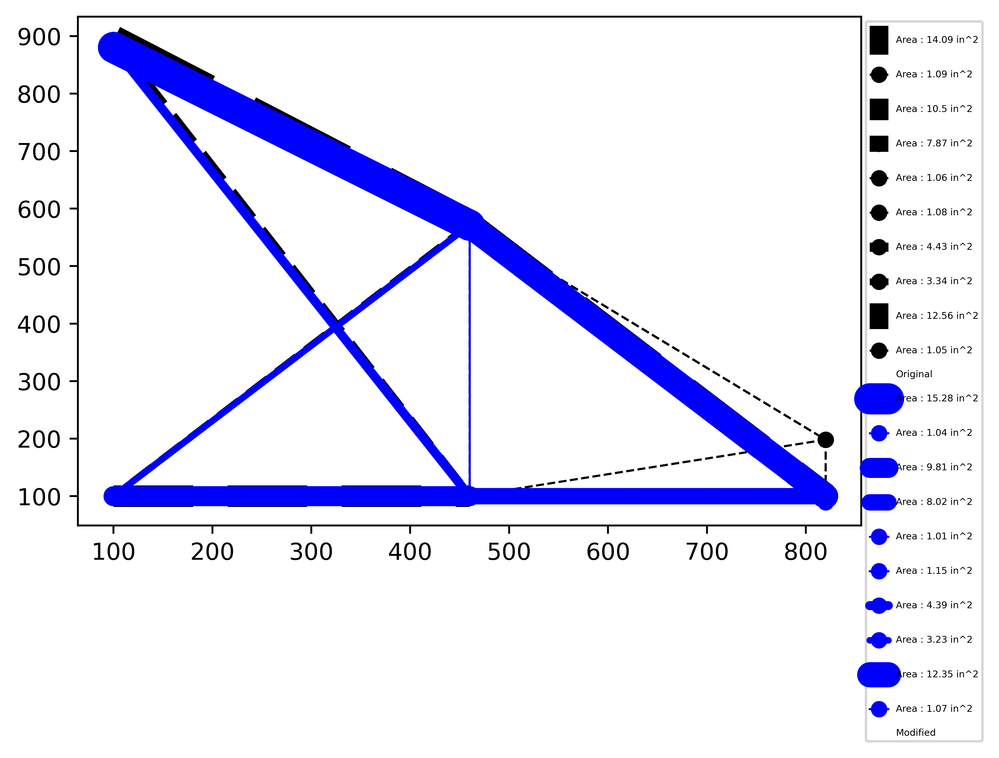

In [ ]:
basic.Plot(new_nodes, 'black', '--',litrature, 'Original')
basic.Plot(d, 'b', '-',a, 'Modified')
# scale = 100
# Dnodes=  U*scale + ga_sol[2]
# Plot(Dnodes, 'g', '-',1, 'Deformed')

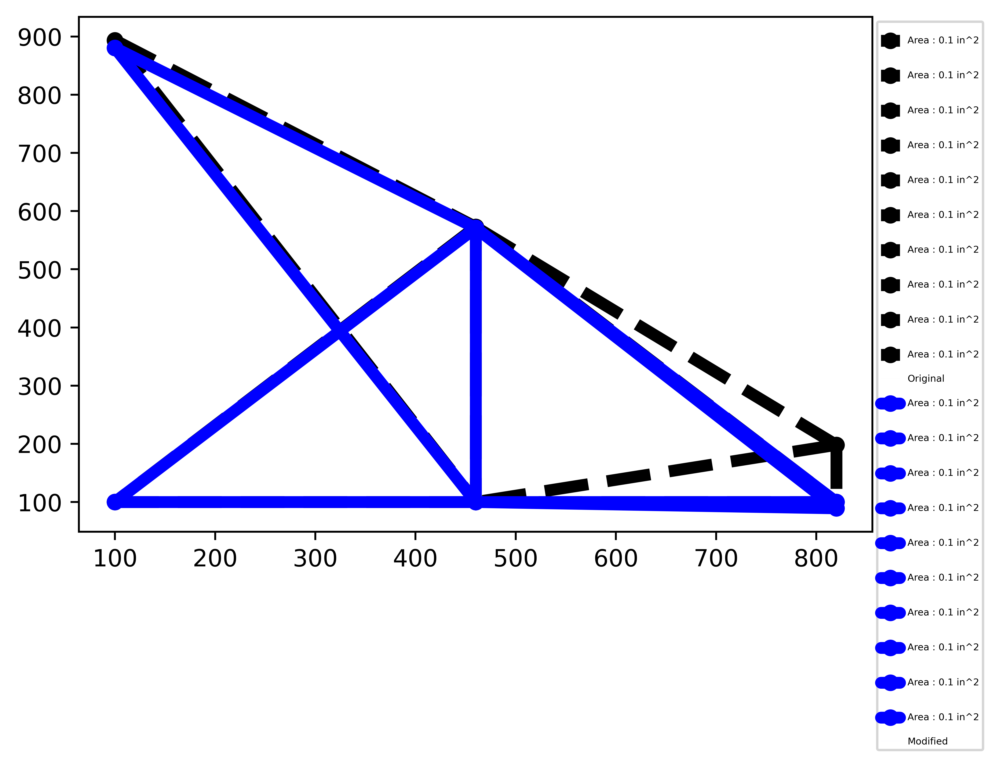

In [ ]:
basic.Plot(new_nodes, 'black', '--',[0.1]*10, 'Original')
basic.Plot(d, 'b', '-',[0.1]*10, 'Modified')

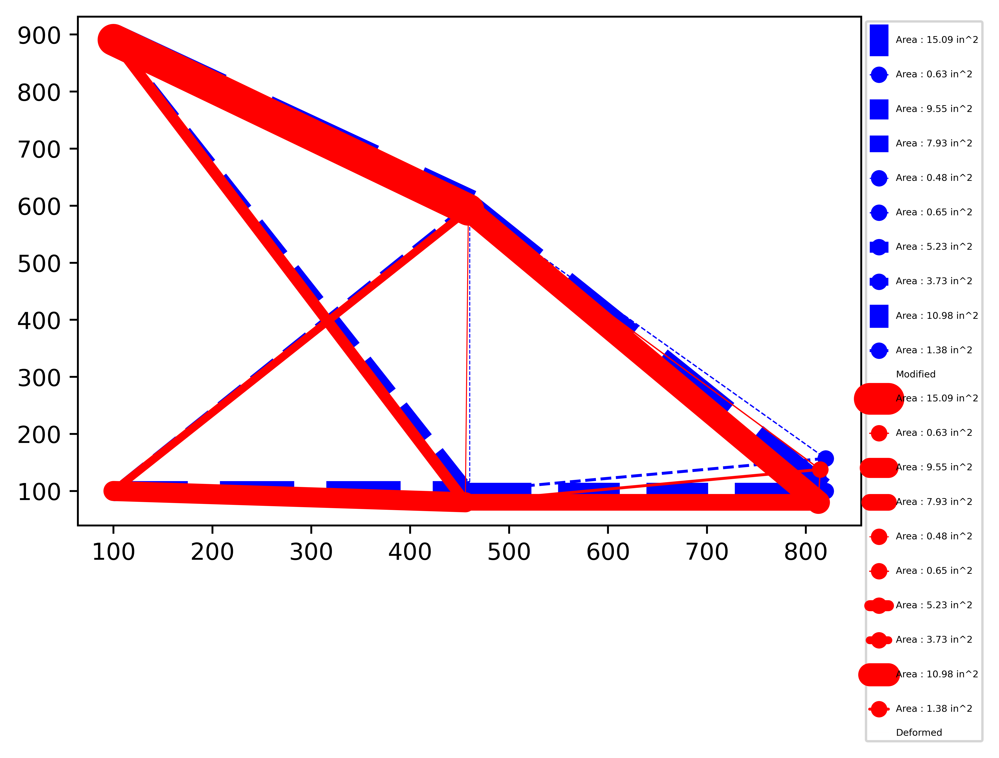

In [ ]:
basic.Plot(d, 'b', '--',a, 'Modified')
scale = 10
Dnodes=  U_const*scale + d
basic.Plot(Dnodes, 'r', '-',a, 'Deformed')

## Comparision plots

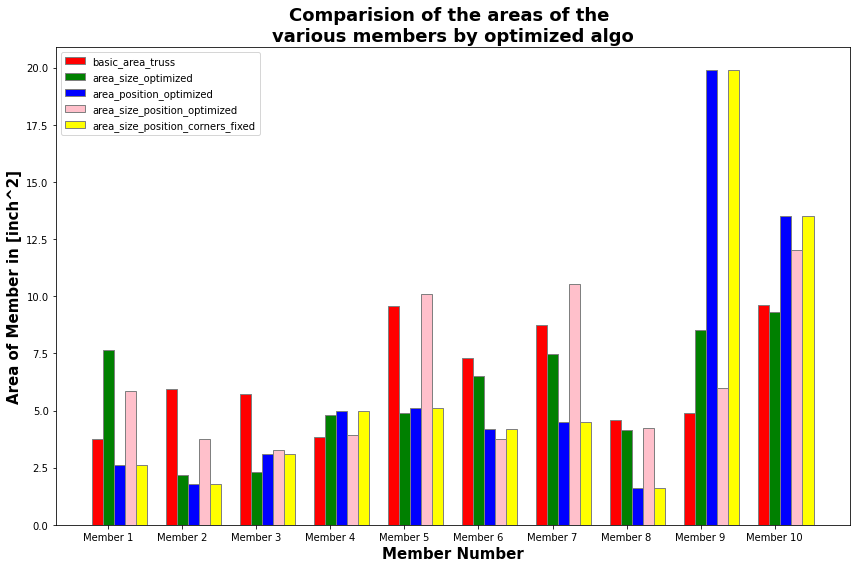

In [ ]:
lst=[]
for i in range(10):
    lst.append(f'Member {i+1}')
barWidth = 0.15
fig = plt.subplots(figsize =(12, 8))
 
# set height of bar
basic_area_truss = a
area_size_optimized = area
area_position_optimized = ga_sol_p[1]
area_size_position_optimized = np.round(ga_sol[1],2)
area_size_position_constant_base = np.round(ga_sol_const_base[1],2)
 
# Set position of bar on X axis
br1 = np.arange(len(basic_area_truss))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
 
# Make the plot
plt.bar(br1, basic_area_truss, color ='r', width = barWidth,
        edgecolor ='grey', label ='basic_area_truss')
plt.bar(br2, area_size_optimized, color ='g', width = barWidth,
        edgecolor ='grey', label ='area_size_optimized')
plt.bar(br3, area_position_optimized, color ='b', width = barWidth,
        edgecolor ='grey', label ='area_position_optimized')
plt.bar(br4, area_size_position_optimized , color ='pink', width = barWidth,
        edgecolor ='grey', label ='area_size_position_optimized')
plt.bar(br5, area_position_optimized, color ='yellow', width = barWidth,
        edgecolor ='grey', label ='area_size_position_corners_fixed')
 
# Adding Xticks
plt.xlabel('Member Number', fontweight ='bold', fontsize = 15)
plt.ylabel('Area of Member in [inch^2]', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(basic_area_truss))], lst)

plt.title("Comparision of the areas of the \nvarious members by optimized algo", fontweight='bold', fontsize=18)
plt.tight_layout()
plt.legend()
plt.show()

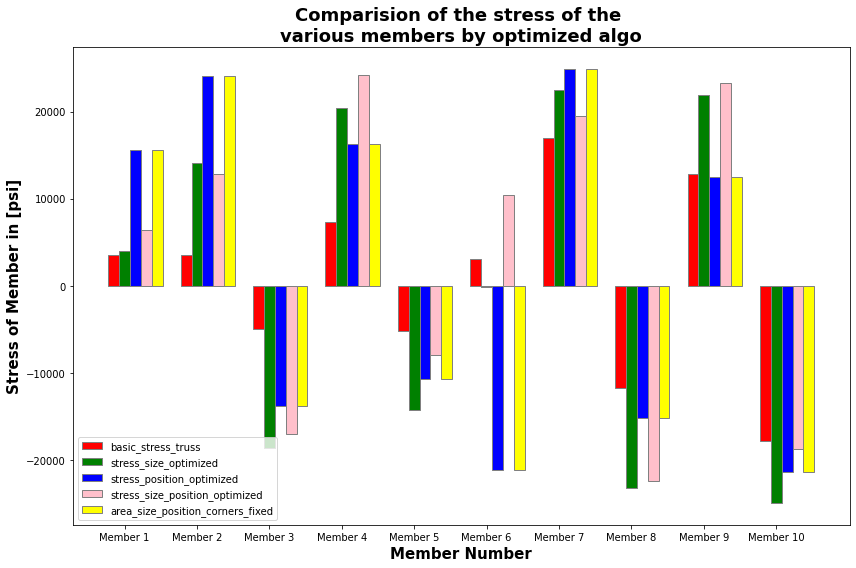

In [ ]:
lst=[]
for i in range(10):
    lst.append(f'Member {i+1}')
barWidth = 0.15
fig = plt.subplots(figsize =(12, 8))
 
# set height of bar
basic_area_truss = a_temp[0]
area_size_optimized = S_size
area_position_optimized = S_po
area_size_position_optimized = S
area_size_position_constant_base = S_const
 
# Set position of bar on X axis
br1 = np.arange(len(basic_area_truss))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
 
# Make the plot
plt.bar(br1, basic_area_truss, color ='r', width = barWidth,
        edgecolor ='grey', label ='basic_stress_truss')
plt.bar(br2, area_size_optimized, color ='g', width = barWidth,
        edgecolor ='grey', label ='stress_size_optimized')
plt.bar(br3, area_position_optimized, color ='b', width = barWidth,
        edgecolor ='grey', label ='stress_position_optimized')
plt.bar(br4, area_size_position_optimized , color ='pink', width = barWidth,
        edgecolor ='grey', label ='stress_size_position_optimized')
plt.bar(br5, area_position_optimized, color ='yellow', width = barWidth,
        edgecolor ='grey', label ='area_size_position_corners_fixed')
 

# Adding Xticks
plt.xlabel('Member Number', fontweight ='bold', fontsize = 15)
plt.ylabel('Stress of Member in [psi]', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(basic_area_truss))], lst)

plt.title("Comparision of the stress of the \nvarious members by optimized algo", fontweight='bold', fontsize=18)
plt.tight_layout()
plt.legend()
plt.show()

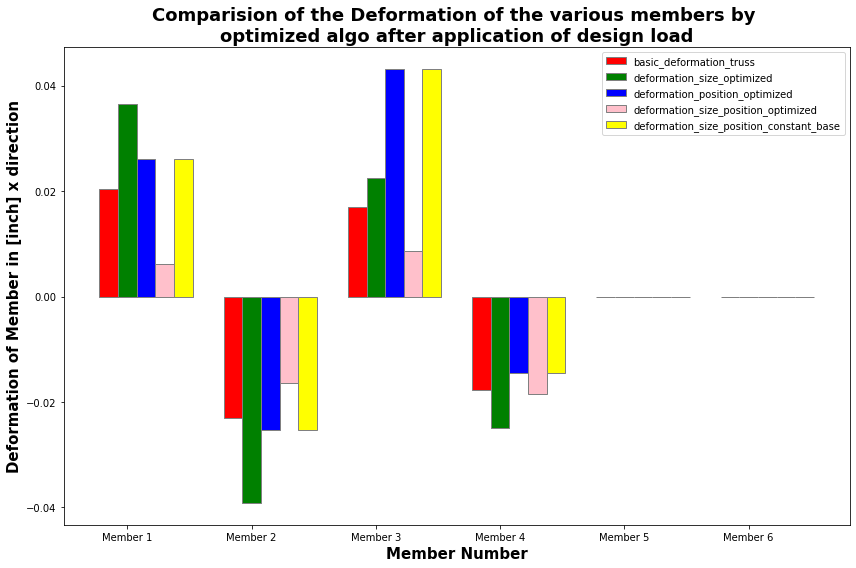

In [ ]:
lst=[]
for i in range(10):
    lst.append(f'Member {i+1}')
barWidth = 0.15
fig = plt.subplots(figsize =(12, 8))
 
# set height of bar
basic_area_truss = a_temp[2][:,0]
area_size_optimized = U_size[:,0]
area_position_optimized = U_po[:,0]
area_size_position_optimized = U[:,0]
area_size_position_constant_base = U_const[:,0]
 
# Set position of bar on X axis
br1 = np.arange(len(basic_area_truss))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
 
# Make the plot
plt.bar(br1, basic_area_truss, color ='r', width = barWidth,
        edgecolor ='grey', label ='basic_deformation_truss')
plt.bar(br2, area_size_optimized, color ='g', width = barWidth,
        edgecolor ='grey', label ='deformation_size_optimized')
plt.bar(br3, area_position_optimized, color ='b', width = barWidth,
        edgecolor ='grey', label ='deformation_position_optimized')
plt.bar(br4, area_size_position_optimized , color ='pink', width = barWidth,
        edgecolor ='grey', label ='deformation_size_position_optimized')
plt.bar(br5, area_position_optimized, color ='yellow', width = barWidth,
        edgecolor ='grey', label ='deformation_size_position_constant_base')
 

# Adding Xticks
plt.xlabel('Member Number', fontweight ='bold', fontsize = 15)
plt.ylabel('Deformation of Member in [inch] x direction', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(basic_area_truss))], lst)

plt.title("Comparision of the Deformation of the various members by \noptimized algo after application of design load", fontweight='bold', fontsize=18)
plt.tight_layout()
plt.legend()
plt.show()

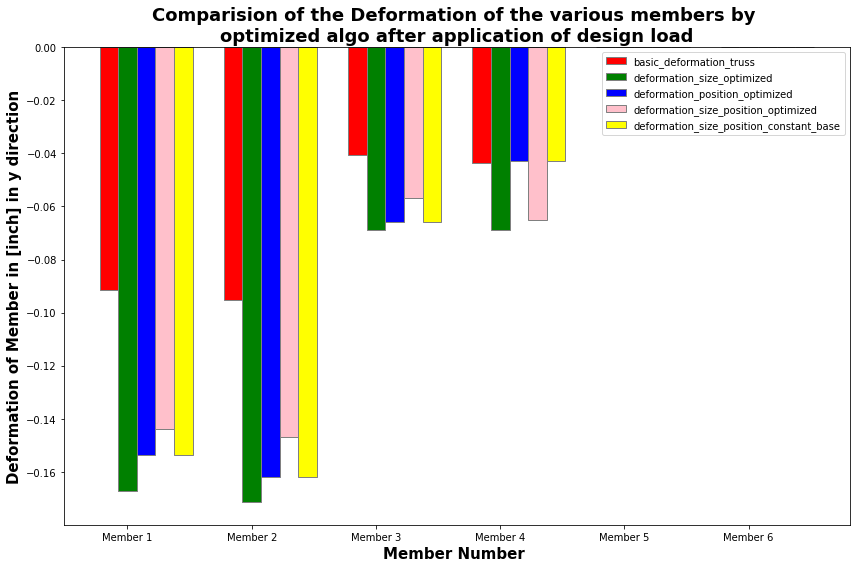

In [ ]:
lst=[]
for i in range(10):
    lst.append(f'Member {i+1}')
barWidth = 0.15
fig = plt.subplots(figsize =(12, 8))
 
# set height of bar
basic_area_truss = a_temp[2][:,1]
area_size_optimized = U_size[:,1]
area_position_optimized = U_po[:,1]
area_size_position_optimized = U[:,1]
area_size_position_constant_base = U_const[:,1]
 
# Set position of bar on X axis
br1 = np.arange(len(basic_area_truss))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
 
# Make the plot
plt.bar(br1, basic_area_truss, color ='r', width = barWidth,
        edgecolor ='grey', label ='basic_deformation_truss')
plt.bar(br2, area_size_optimized, color ='g', width = barWidth,
        edgecolor ='grey', label ='deformation_size_optimized')
plt.bar(br3, area_position_optimized, color ='b', width = barWidth,
        edgecolor ='grey', label ='deformation_position_optimized')
plt.bar(br4, area_size_position_optimized , color ='pink', width = barWidth,
        edgecolor ='grey', label ='deformation_size_position_optimized')
plt.bar(br5, area_position_optimized, color ='yellow', width = barWidth,
        edgecolor ='grey', label ='deformation_size_position_constant_base')
 

# Adding Xticks
plt.xlabel('Member Number ', fontweight ='bold', fontsize = 15)
plt.ylabel('Deformation of Member in [inch] in y direction', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(basic_area_truss))], lst)

plt.title("Comparision of the Deformation of the various members by \noptimized algo after application of design load", fontweight='bold', fontsize=18)
plt.tight_layout()
plt.legend()
plt.show()

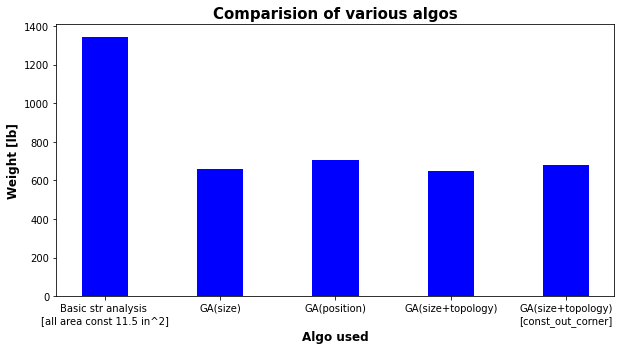

In [ ]:
data = {'Basic str analysis \n[all area const 11.5 in^2]':a_temp[1], 'GA(size)':M_size, 'GA(position)':M_po, 'GA(size+topology)':M,
      'GA(size+topology)\n[const_out_corner]':M_const,  }
Algo = list(data.keys())
values = list(data.values())
  
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(Algo, values, color ='b', alpha =1,
        width = 0.4)
 
plt.xlabel("Algo used", fontweight ='bold', fontsize = 12)
plt.ylabel("Weight [lb]", fontweight ='bold', fontsize = 12)
plt.title("Comparision of various algos", fontweight ='bold', fontsize = 15)
plt.show()

# 6 Node, 10 Bar Truss

## Defining the geometery of the truss

In [ ]:
E = 10e7 #68947572.93178 # KN/m^2 (10e7 psi) modulus_of_elasticity
p = 0.1  #27.1447138 # KN/m^3 (0.1 lb/in^3) weight_density
s_lim = 25000 #172368.93233 #KN/m^2 (25000 psi) # allowable_stress_compression = 172368.93233 #KN/m^2 (25000 psi)
d_lim =  2 #0.0508 #m (2 inch) #displacemnt limit

In [ ]:
area_avalival = [1.62, 1.80,2.38, 2.62, 2.88, 3.09, 3.13,
3.38,3.63,3.84,3.87,4.18,4.49,4.80,4.97,5.12, 5.74, 7.22,
7.97,11.5,13.5,13.9,14.2,15.5,16.0,18.8,19.9,22.0,22.9,
26.5, 30.0, 33.5]  ## sq inch

In [ ]:
nodes, bars =[], []

nodes.append([100,460]) #node0
nodes.append([460,460]) #node1
nodes.append([820,460]) #node2
nodes.append([100,100]) #node3
nodes.append([460,100]) #node4
nodes.append([820,100]) #node5

bars.append([0,1]) #bar1  #dont forget python starts with 0
bars.append([1,2]) #bar2

bars.append([3,4]) #bar3
bars.append([4,5]) #bar4


bars.append([1,4]) #bar5
bars.append([2,5]) #bar6

bars.append([0,4]) #bar7
bars.append([1,3]) #bar8

bars.append([1,5]) #bar9
bars.append([2,4]) #bar10

nodes = np.array(nodes).astype(float)
bars = np.array(bars)
original_nodes = np.copy(nodes)

In [ ]:
!pip install matplotx

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


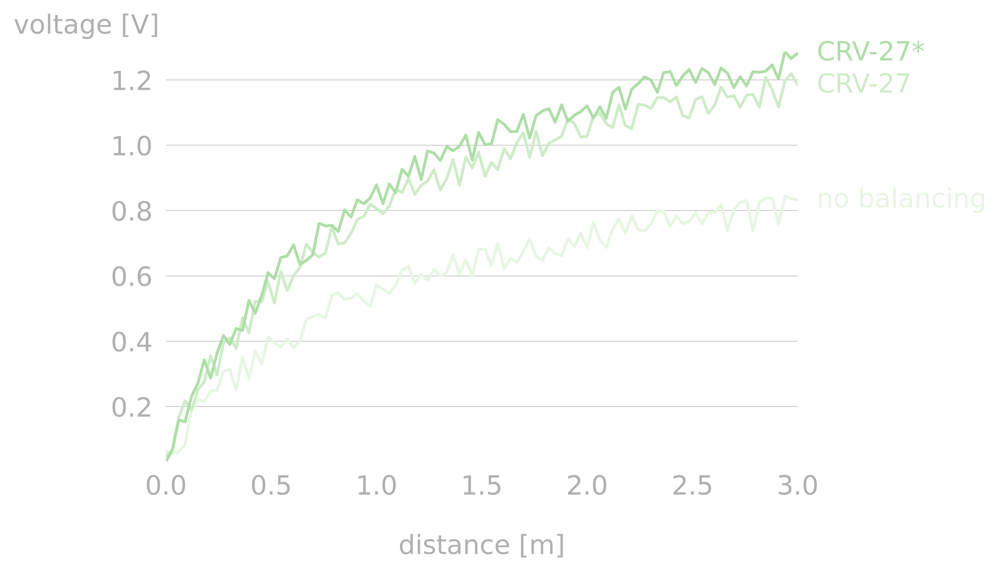

In [ ]:

import matplotlib.pyplot as plt
import matplotx
import numpy as np

# create data
rng = np.random.default_rng(0)
offsets = [1.0, 1.50, 1.60]
labels = ["no balancing", "CRV-27", "CRV-27*"]
x0 = np.linspace(0.0, 3.0, 100)
y = [offset * x0 / (x0 + 1) + 0.1 * rng.random(len(x0)) for offset in offsets]

# plot
with plt.style.context(matplotx.styles.dufte):
    for yy, label in zip(y, labels):
        plt.plot(x0, yy, label=label)
    plt.xlabel("distance [m]")
    matplotx.ylabel_top("voltage [V]")  # move ylabel to the top, rotate
    matplotx.line_labels()  # line labels to the right
    plt.show()

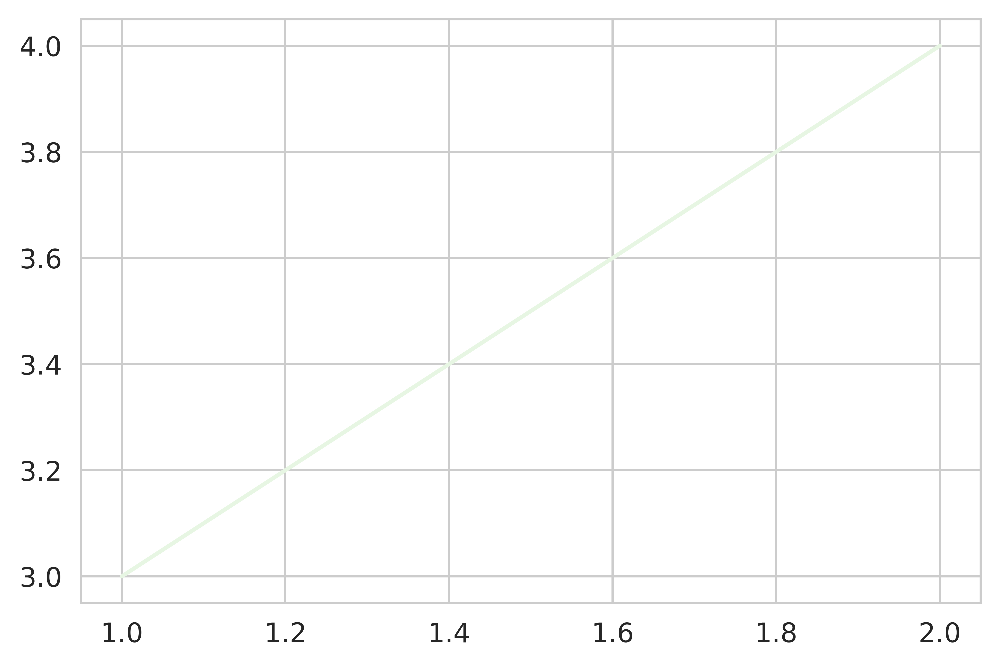

In [ ]:
line = plt.plot((1,2),(3,4), alpha=1)
labelLines(plt.gca().get_lines(),align=False,fontsize=14)
#inline_legend(plt.gca().get_lines(), n_markers=3)
#line.set_label('Ground str')
#plt.legend(plt.gca().get_lines(), n_markers=3)
plt.show()

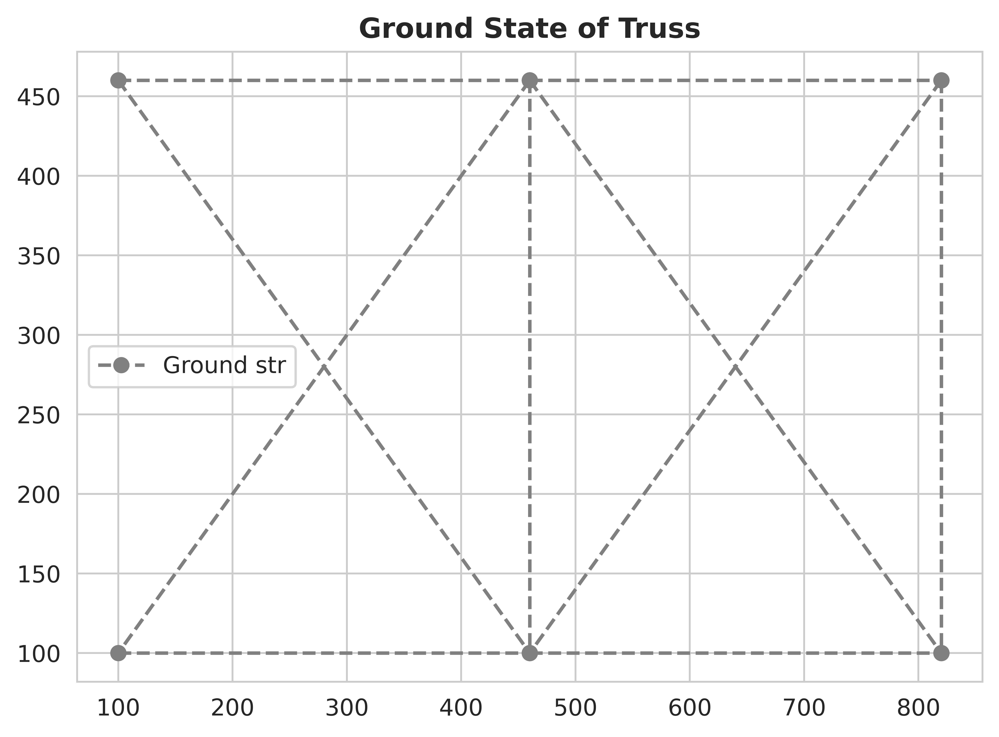

In [ ]:
plt.figure(figsize=(7,5))
plt.title("Ground State of Truss", fontweight='bold')
for i in range(len(bars)):
    xi, xf = nodes[bars[i,0],0], nodes[bars[i, 1],0]
    yi, yf = nodes[bars[i, 0], 1], nodes[bars [i, 1],1]
    line, = plt.plot([xi, xf], [yi, yf], color='grey', linestyle='--', marker='o') 

line.set_label('Ground str')
plt.legend()
plt.show()

In [ ]:
P = np.zeros_like(nodes) # 0 =nO LOAD # 1 == lOAD
P[4,1]= -100000
P[5,1]= -100000
print(P)

[[      0.       0.]
 [      0.       0.]
 [      0.       0.]
 [      0.       0.]
 [      0. -100000.]
 [      0. -100000.]]


In [ ]:
Ur = [0,0,0,0]

In [ ]:
# Defining the degrees of Freedoms
DOFCON = np.ones_like(nodes).astype(int)
DOFCON[0,:] = 0
DOFCON[3,:] = 0
print(DOFCON)

[[0 0]
 [1 1]
 [1 1]
 [0 0]
 [1 1]
 [1 1]]


In [ ]:
len(bars)

10

## Truss Analysis
### Doing structural analysis of the truss for an constant area of 11.5 inch^2

In [ ]:
@jax.jit
class basic(): 
    def area_gen(area):
        area_new = []
        for i in range(10):
            area_new.append(random.choice(area))
        return area_new

    def scaler(area):
        f=[]
        a = sum(area)
        for i in area:
            i=i*50
            f.append(i/a)
        return f

    def Plot(nodes, c, lt, area, lg):
        for i in range(len(bars)):
            xi, xf = nodes[bars[i,0],0], nodes[bars[i,1],0]
            yi, yf = nodes[bars[i,0],1], nodes[bars[i,1],1]
            a = np.round(basic.scaler(area), 3)
            line, = plt.plot([xi, xf], [yi,yf], color=c, linestyle=lt, linewidth=a[i],
                             label=f'\nArea : {area[i]} in^2\n', marker='o') #
        inline_legend(plt.gca().get_lines(), n_markers=3)
        line.set_label(lg)
        plt.legend(bbox_to_anchor=(1,1), loc="upper left", prop={'size':4})
    

    def check( STRESS, DEFLECTION):
        x=0
        y=0
        for i in STRESS:
            if np.abs(i) > s_lim:
                x +=1
                # print("Failed in Stress")
            else:
                pass
                #print("Pass in Stress")
        for i in range(6):
            ix = np.abs(DEFLECTION[i][0])
            iy = np.abs(DEFLECTION[i][1])
            if ix > d_lim:
                y+=1
                #print("Failed in Deflection along X")
            elif iy > d_lim:
                y +=1
                #print("Failed in Deflection along Y")
            else:
                pass
                #print("Pass in Deflection")
        if (x ==0) & (y==0):
            # print("Pass")
            return "Pass"
        else:
            # print(f'Failed in {x} ways for stress \n Failed in {y} ways for deflection ')
            return f'Failed in {x} ways for stress \n Failed in {y} ways for deflection '

@jax.jit
class Truss():
    # Truss Structural Analysis
    def TrussAnalysis(A, nodes, bars):
        NN = len(nodes) # number of nodes
        NE = len(bars) # number of deges
        # print(NE)

        DOF = 2 # defree of freedom
        NDOF = DOF*NN # total degree of freedom

        #structural analysis using direct stifness method

        # for bar no 3
        # takes info from node no 3 and substract it from infor of node no 2
        d = nodes[bars[:,1],:] - nodes[bars[:,0],:]
        
        L = np.sqrt((d**2).sum(axis=1)) #leangth of the bar
        # print(f"The Leangth is {L}")
        #computing the angle 
        angle = d.T/L
        # print(f"The angle is \n\n{angle}\n\n")
        #transformation vector {a ==Transformation vector}
        a = np.concatenate((-angle.T, angle.T), axis=1)
        # print(f"The transformation vector is \n\n{a}\n\n")

        #Global stifness matrix K
        K = np.zeros([NDOF,NDOF])
        
        
        for k in range(NE):
            aux = 2*bars[k,:]
            #gives you degree of freedom in each node
            index = np.r_[aux[0]:aux[0]+2, aux[1]:aux[1]+2]
            # print(f'a : {a.shape}, A: {A.shape}, L: {L.shape}')
            ES = np.dot(a[k][np.newaxis].T*E*A[k], a[k][np.newaxis])/L[k]
            # print(f"Stifness Matrix \n\n{ES}\n\n")
            K[np.ix_(index,index)] = K[np.ix_(index,index)] + ES

        freeDOF = DOFCON.flatten().nonzero()[0]
        supportDOF = (DOFCON.flatten()==0).nonzero()[0]

        Kff = K[np.ix_(freeDOF, freeDOF)]
        Kfr = K[np.ix_(freeDOF, supportDOF)]
        Krf = Kfr.T
        # print(f'{Kfr}, \n \n {Kff}, \n \n {Krf}')
        Krr = K[np.ix_(supportDOF, supportDOF)]
        
        Pf = P.flatten()[freeDOF]
        Uf = np.linalg.solve(Kff, Pf)
        U  = DOFCON.astype(float).flatten()
        U[freeDOF] = Uf
        U[supportDOF] = Ur

        U = U.reshape(NN, DOF) #displacement of the truss members
        u = np.concatenate((U[bars[:,0]], U[bars[:,1]]), axis=1)
        # print(E)
        # print(A)
        N = E*A[:]/L[:]*(a[:]*u[:]).sum(axis=1)
        R = (Krf[:]*Uf).sum(axis=1) + (Krr[:]*Ur).sum(axis=1) #Reaction Force
        R = R.reshape(2,DOF)

        # Stress
        S = N/A

        #weight of str
        Volume = (1*A*L).sum() #for mass replace 1 by p

        #check
        c = basic.check(S, U)

        return S, Volume, U, c, R

basic = jax.jit(basic)
Truss = jax.jit(Truss)

In [ ]:
a = [11.5]*7 #area_gen(area_avalival)

In [ ]:
a = [3.17, 1, 2.81, 2.16, 1, 1, 1.83, 2.62, 2.55, 1]

In [ ]:
a = [31.82, 1, 23.74, 15.32, 1, 1, 8.67, 22.09, 21.70, 1]

In [ ]:
a = np.array(a)

In [ ]:
a

array([31.82,  1.  , 23.74, 15.32,  1.  ,  1.  ,  8.67, 22.09, 21.7 ,
        1.  ])

In [ ]:
# le = [360.   ,      360.    ,     360.       ,  360.   ,      360.,
#  360.  ,       509.11688245 ,509.11688245 ,509.11688245 ,509.11688245]

In [ ]:
# v = []
# for i, b in zip(a,le):
#     print(i,b)
#     v.append(i*b)

3.17 360.0
1.0 360.0
2.81 360.0
2.16 360.0
1.0 360.0
1.0 360.0
1.83 509.11688245
2.62 509.11688245
2.55 509.11688245
1.0 509.11688245


In [ ]:
# v

[1141.2,
 360.0,
 1011.6,
 777.6,
 360.0,
 360.0,
 931.6838948835,
 1333.886232019,
 1298.2480502474998,
 509.11688245]

In [ ]:
# sum(v)

8083.3350596

In [ ]:
# 57368/8083


7.097364839787208

In [ ]:
a, nodes, bars

(array([31.82,  1.  , 23.74, 15.32,  1.  ,  1.  ,  8.67, 22.09, 21.7 ,
         1.  ]), array([[100., 460.],
        [460., 460.],
        [820., 460.],
        [100., 100.],
        [460., 100.],
        [820., 100.]]), array([[0, 1],
        [1, 2],
        [3, 4],
        [4, 5],
        [1, 4],
        [2, 5],
        [0, 4],
        [1, 3],
        [1, 5],
        [2, 4]]))

In [ ]:
a_temp = Truss.TrussAnalysis(a, nodes, bars)

In [ ]:
print(f""" 
The Stress in the various members of the truss is \x1B[3mpsi\x1B[0m : \n{a_temp[0]}\n\n 
The Volume of the the truss is \x1B[3m inch^3 \x1B[0m : {a_temp[1]}\n
The nodal displacements [x & y] in \x1B[3minch\x1B[0m : \n{a_temp[2]}\n\n 
Results for check for stress and deflection limit : {a_temp[3]}\n
The reaction of the supports [x & y] in \x1B[3mpsi\x1B[0m : \n{a_temp[4]} """)

 
The Stress in the various members of the truss is psi : 
[ 6717.14998464   966.4486943  -7845.84193297 -6464.33102518
 14706.1612056    966.4486943  14070.41158716 -7281.67695853
  6454.12863532 -1366.76485081]

 
The Volume of the the truss is  inch^3  : 53814.18853600764

The nodal displacements [x & y] in inch : 
[[ 0.          0.        ]
 [ 0.02418174 -0.07660981]
 [ 0.02766096 -0.19529869]
 [ 0.          0.        ]
 [-0.02824503 -0.12955199]
 [-0.05151662 -0.1987779 ]]

 
Results for check for stress and deflection limit : Pass

The reaction of the supports [x & y] in psi : 
[[-300000.          86260.2874887]
 [ 300000.         113739.7125113]] 


IndexError: ignored

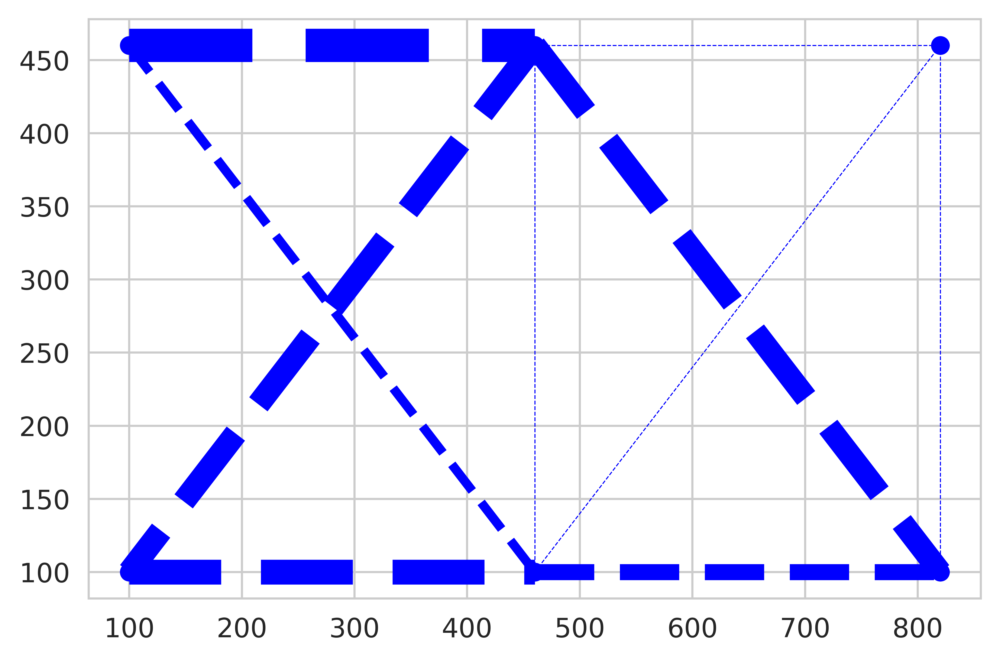

In [ ]:
basic.Plot(nodes, 'b', '--',a, 'Original')
scale = 100
Dnodes=  a_temp[2]*scale + nodes
basic.Plot(Dnodes, 'r', '-',a, 'Deformed')

## GA (size) 
### Changing the area of cross section of the members, treating them as continous values

In [ ]:

#algo
@jax.jit
class solution():
    def ga_solution(Nodes, Bar):

        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss = np.abs(ans[1]) #np.abs(ans[0]).sum()*0.0001 + np.abs(ans[1]) + np.abs(ans[2]).sum()
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -1/loss #"Unstable solution"

        #generate solutions
        solutions, global_best =[], []
        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival))

        
        for i in range(100):
            ranked_soln = []
            # print(solutions)
            #for s, bars in zip(solutions, Bar):
                #print(np.array(b))
            for s in solutions:
                tt = fitness(np.array(s), Nodes, bars)
                ranked_soln.append((tt,s))

            # print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.sort()
            # ranked_soln.reverse()

            if ranked_soln[0][0] >999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:100]
            global_best.append(ranked_soln[0])
            elements =[]
            for s in best_soln:
                elements.append(s[1][0])
                elements.append(s[1][1])
                elements.append(s[1][2])
                elements.append(s[1][3])
                elements.append(s[1][4])
                elements.append(s[1][5])
                elements.append(s[1][6])
                elements.append(s[1][7])
                elements.append(s[1][8])
                elements.append(s[1][9])

            new_gen = []
            for _ in range(1000):
                e1 = np.random.choice(elements)*np.random.uniform(0.95,1.05) #mutating all solns by 5%
                e2 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e3 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e4 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e5 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e6 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e7 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e8 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e9 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e10 = np.random.choice(elements)*np.random.uniform(0.95,1.05)

                new_gen.append(np.array([e1,e2,e3,e4,e5,e6,e7,e8,e9,e10]))


            solutions = new_gen
            print(f'The generation {i}, has best solution {ranked_soln[0]}')
            # if i%50==0:
            #     print(f'The generation {i}, has best solution {ranked_soln[0]}')
            # else:
            #     pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])  
        return global_best[0]

solution = jax.jit(solution)

In [ ]:
ga_size = solution.ga_solution(nodes,bars)

The generation 0, has best solution (4.1560761864533167e-05, [7.22, 3.13, 14.2, 3.63, 5.74, 1.62, 11.5, 3.13, 3.63, 3.87])
The generation 1, has best solution (2.5960651917187553e-05, array([ 5.84135124,  7.59145232, 20.92237999,  2.58661437,  4.39720629,
        3.13798937, 22.36389954, 14.64195477,  3.9641234 ,  3.24013787]))
The generation 2, has best solution (3.6892955771097884e-05, array([ 6.79180415,  2.88422056, 19.42092299,  3.862212  ,  3.5991134 ,
        1.7182133 , 15.24429794,  3.95380062,  3.76357283,  3.21288852]))
The generation 3, has best solution (3.2964318615247356e-05, array([ 6.45584411, 11.66181109, 12.12036244,  5.05331201,  5.09817241,
        6.36242786, 13.84382489,  3.20652236,  4.47806029,  4.99818535]))
The generation 4, has best solution (3.2725066581734086e-05, array([10.27407509,  7.71310175, 11.16909946,  3.93726242,  4.0189106 ,
       11.7121176 ,  4.78450691, 13.94125165,  3.32652248,  3.44436188]))
The generation 5, has best solution (3.5141113376

In [ ]:
ga_size

(4.1560761864533167e-05,
 [7.22, 3.13, 14.2, 3.63, 5.74, 1.62, 11.5, 3.13, 3.63, 3.87])

In [ ]:
area = np.round(ga_size[1], 2)
area

array([ 7.22,  3.13, 14.2 ,  3.63,  5.74,  1.62, 11.5 ,  3.13,  3.63,
        3.87])

In [ ]:
S_size, M_size, U_size, c_size, R_size = Truss.TrussAnalysis(area, nodes, bars)

In [ ]:
S_size

array([ 19900.65195651,  12715.27152701, -18050.51358267, -16584.35265027,
        -2877.78623597,  24567.16041947,  19223.13353181, -19736.95746287,
        23453.81644118, -14543.66991106])

In [ ]:
M_size

24061.156608713976

In [ ]:
U_size

array([[ 0.        ,  0.        ],
       [ 0.07164235, -0.21374844],
       [ 0.11741732, -0.49050201],
       [ 0.        ,  0.        ],
       [-0.06498185, -0.20338841],
       [-0.12468552, -0.57894378]])

In [ ]:
c_size

'Pass'

In [ ]:
R_size

array([[-300000.        ,  156317.29287398],
       [ 300000.        ,   43682.70712602]])

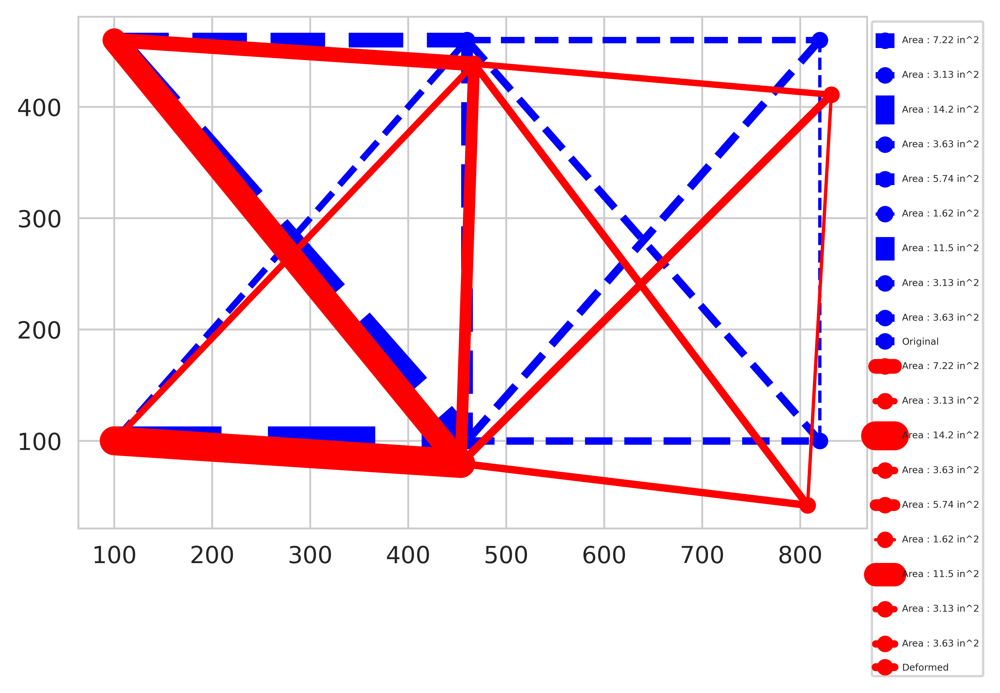

In [ ]:
basic.Plot(nodes, 'b', '--',ga_size[1], 'Original')
scale = 100
Dnodes=  U_size*scale + nodes
basic.Plot(Dnodes, 'r', '-',ga_size[1], 'Deformed')

## GA (position) {both x & y -dir}
### Treating the areas as discrete values as cited from the litrature and optimizing only the topolgy

In [ ]:
@jax.jit
class position():
    def ga_solution(Nodes, Bar):

        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss =  np.abs(ans[1]) #+ np.abs(ans[2]).sum() +np.abs(ans[0]).sum()*0.0001 +
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -999 #"Unstable solution"

        #generate solutions
        solutions, position, global_best = [], [],[]


        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival))

        for p in range(1000):
            position.append(Nodes)
        
        for i in range(250):
            ranked_soln = []
            # print(solutions)
            for s, Nodes in zip(solutions,position):
                # print(s)
                ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

            # print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.sort()
            # ranked_soln.reverse()

            if ranked_soln[0][0] > 999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:100]
            global_best.append(ranked_soln[0])

            element_x, element_y = [], []
            for ix in range(6):
                    element_x.append(nodes[ix][0])
                    element_y.append(nodes[ix][1])

            new_pos_x, new_pos_y = [], []
            for iy in range(1000):
                xn1 = element_x[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                xn2 = element_x[1]*np.random.uniform(0.80,1.20) #node1
                xn3 = element_x[2]*np.random.uniform(0.80,1.20) #node2
                xn4 = element_x[3]#*np.random.uniform(0.80,1.20) #node3
                # xn5 = element_x*np.random.uniform(0.80,1.20) #node4
                # xn6 = element_x*np.random.uniform(0.80,1.20) #node5
                xn5 = element_x[4]
                xn6 = element_x[5]
                new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

                yn1 = element_y[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                yn2 = element_y[1]*np.random.uniform(0.80,1.20) #node1
                yn3 = element_y[2]*np.random.uniform(0.80,1.20) #node2
                yn4 = element_y[3]#*np.random.uniform(0.80,1.20) #node3
                # yn5 = element_y)*np.random.uniform(0.80,1.20) #node4
                # yn6 = element_y)*np.random.uniform(0.80,1.20) #node5
                yn5 = element_y[4]
                yn6 = element_y[5]
                new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

            # print(new_pos_x[0])
            # print(new_pos_y[0])

            new_pos_star = []
            for iq in range(1000):
                new_pos = []
                for iz in range(6):
                    new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
                new_pos_star.append(np.array(new_pos))
            position = new_pos_star
            if i%50==0:
                print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
            else:
                pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])  
        return global_best[0]
        
position = jax.jit(position)

In [ ]:
ga_sol_p = position.ga_solution(nodes, bars)


The generation 0, best solution : 
optimization value : 2.6889983834756243e-05
area : [11.5, 2.62, 14.2, 7.97, 4.97, 3.38, 18.8, 2.38, 4.8, 15.5] 
deformations : [[100. 460.]
 [460. 460.]
 [820. 460.]
 [100. 100.]
 [460. 100.]
 [820. 100.]]


The generation 50, best solution : 
optimization value : 2.833206541674556e-05
area : [14.2, 4.49, 15.5, 3.09, 26.5, 2.88, 14.2, 4.97, 2.38, 3.09] 
deformations : [[101.38906641 444.13794944]
 [460.         460.        ]
 [665.39467024 426.40229354]
 [100.         100.        ]
 [460.         100.        ]
 [820.         100.        ]]


The generation 100, best solution : 
optimization value : 2.7464213797225315e-05
area : [11.5, 2.62, 14.2, 7.97, 4.97, 3.38, 18.8, 2.38, 4.8, 15.5] 
deformations : [[107.36290052 401.54751564]
 [460.         460.        ]
 [848.462749   438.32301066]
 [100.         100.        ]
 [460.         100.        ]
 [820.         100.        ]]


The generation 150, best solution : 
optimization value : 3.286023334999972

In [ ]:
ga_sol_p

(3.389896913233855e-05,
 [18.8, 4.49, 14.2, 3.87, 2.62, 5.12, 19.9, 2.38, 1.62, 5.12],
 array([[115.50360627, 370.35195368],
        [460.        , 460.        ],
        [703.3422594 , 380.73913569],
        [100.        , 100.        ],
        [460.        , 100.        ],
        [820.        , 100.        ]]))

In [ ]:
hh = np.round(ga_sol_p[2],2)
hh

array([[115.5 , 370.35],
       [460.  , 460.  ],
       [703.34, 380.74],
       [100.  , 100.  ],
       [460.  , 100.  ],
       [820.  , 100.  ]])

In [ ]:
S_po, M_po, U_po, c_po, R_po = Truss.TrussAnalysis(np.array(ga_sol_p[1]), hh, bars)

In [ ]:
S_po

array([  7774.05948081,  19781.8294499 , -24573.9439451 , -13085.46392233,
       -14664.36589023,  17862.26576776,  15902.28228894, -24624.84542495,
        13571.71875491, -14718.7448159 ])

In [ ]:
M_po

29499.522885339466

In [ ]:
R_po

array([[-390391.50456223,  158558.49945815],
       [ 390391.50456223,   41441.50054185]])

In [ ]:
U_po

array([[ 0.        ,  0.        ],
       [ 0.10102385, -0.27832274],
       [ 0.09585384, -0.4576626 ],
       [ 0.        ,  0.        ],
       [-0.0884662 , -0.22553102],
       [-0.13557387, -0.61263684]])

In [ ]:
c_po

'Pass'

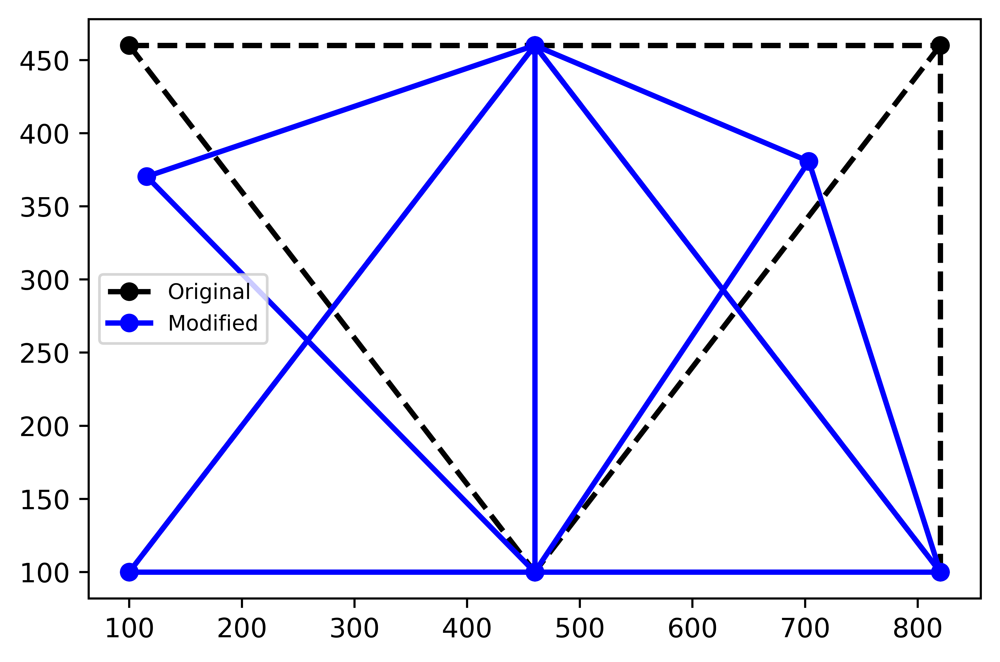

In [ ]:
basic.Plot(nodes, 'black', '--',2, 'Original')
basic.Plot(hh, 'b', '-',2, 'Modified')

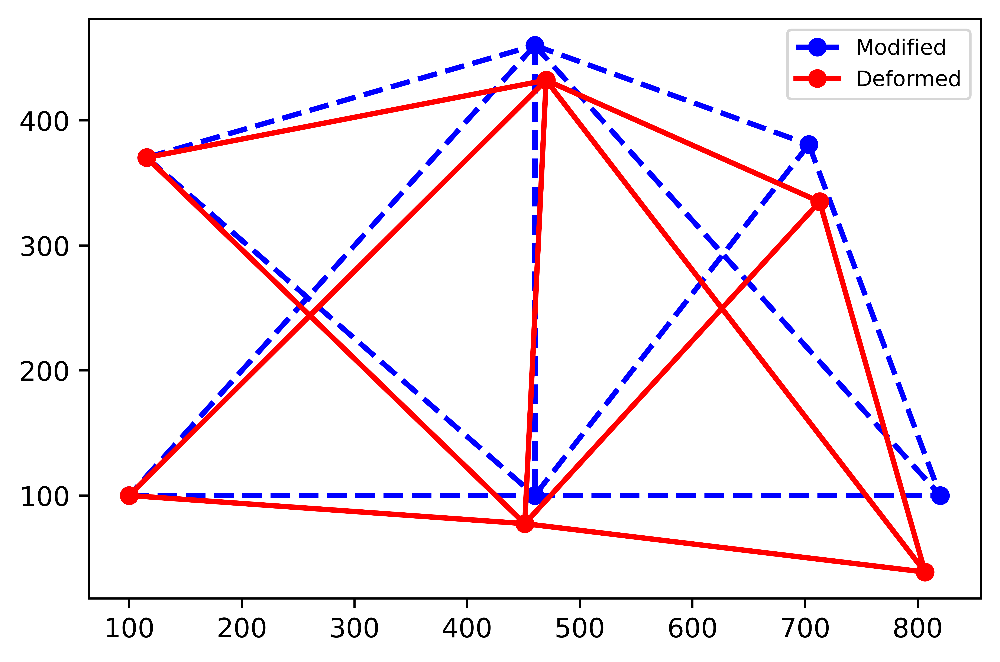

In [ ]:
basic.Plot(hh, 'b', '--',2, 'Modified')
scale = 100
Dnodes=  U_po*scale + hh
basic.Plot(Dnodes, 'r', '-',2, 'Deformed')

## GA (position) {only x -dir}
### Treating the areas as discrete values as cited from the litrature and optimizing only the topolgy

In [ ]:
@jax.jit
class position():
    def ga_solution(Nodes, Bar):

        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss =  np.abs(ans[1]) #+ np.abs(ans[2]).sum() +np.abs(ans[0]).sum()*0.0001 +
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -999 #"Unstable solution"

        #generate solutions
        solutions, position, global_best = [], [],[]


        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival))

        for p in range(1000):
            position.append(Nodes)
        
        for i in range(250):
            ranked_soln = []
            # print(solutions)
            for s, Nodes in zip(solutions,position):
                # print(s)
                ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

            # print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.sort()
            # ranked_soln.reverse()

            if ranked_soln[0][0] > 999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:100]
            global_best.append(ranked_soln[0])

            element_x, element_y = [], []
            for ix in range(6):
                    element_x.append(nodes[ix][0])
                    element_y.append(nodes[ix][1])

            new_pos_x, new_pos_y = [], []
            for iy in range(1000):
                xn1 = element_x[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                xn2 = element_x[1]#*np.random.uniform(0.80,1.20) #node1
                xn3 = element_x[2]*np.random.uniform(0.80,1.20) #node2
                xn4 = element_x[3]*np.random.uniform(0.80,1.20) #node3
                # xn5 = element_x*np.random.uniform(0.80,1.20) #node4
                # xn6 = element_x*np.random.uniform(0.80,1.20) #node5
                xn5 = element_x[4]
                xn6 = element_x[5]
                new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

                yn1 = element_y[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                yn2 = element_y[1]#*np.random.uniform(0.80,1.20) #node1
                yn3 = element_y[2]#*np.random.uniform(0.80,1.20) #node2
                yn4 = element_y[3]#*np.random.uniform(0.80,1.20) #node3
                # yn5 = element_y)*np.random.uniform(0.80,1.20) #node4
                # yn6 = element_y)*np.random.uniform(0.80,1.20) #node5
                yn5 = element_y[4]
                yn6 = element_y[5]
                new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

            # print(new_pos_x[0])
            # print(new_pos_y[0])

            new_pos_star = []
            for iq in range(1000):
                new_pos = []
                for iz in range(6):
                    new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
                new_pos_star.append(np.array(new_pos))
            position = new_pos_star
            if i%50==0:
                print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
            else:
                pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])  
        return global_best[0]
        
position = jax.jit(position)

In [ ]:
ga_sol_p = position.ga_solution(nodes, bars)


The generation 0, best solution : 
optimization value : 0.001069483667579201
area : [2.62, 5.12, 1.8, 4.49, 18.8, 13.5, 7.22, 2.38, 14.2, 13.9] 
deformations : [[300. 200.]
 [300. 100.]
 [200. 200.]
 [200. 100.]
 [100. 200.]
 [100. 100.]]


The generation 50, best solution : 
optimization value : 0.0011308970115100861
area : [3.87, 3.38, 4.8, 4.8, 7.97, 2.62, 14.2, 11.5, 7.97, 22.9] 
deformations : [[300.         200.        ]
 [300.         100.        ]
 [182.74359807 200.        ]
 [169.25434342 100.        ]
 [100.         200.        ]
 [100.         100.        ]]


The generation 100, best solution : 
optimization value : 0.0010995629816546936
area : [3.87, 3.38, 4.8, 4.8, 7.97, 2.62, 14.2, 11.5, 7.97, 22.9] 
deformations : [[300.         200.        ]
 [300.         100.        ]
 [171.71393911 200.        ]
 [194.02897518 100.        ]
 [100.         200.        ]
 [100.         100.        ]]


The generation 150, best solution : 
optimization value : 0.0011234675245562265
a

In [ ]:
ga_sol_p

(0.001188553542520782,
 [3.87, 3.38, 4.8, 4.8, 7.97, 2.62, 14.2, 11.5, 7.97, 22.9],
 array([[300.        , 200.        ],
        [300.        , 100.        ],
        [160.84563621, 200.        ],
        [161.08787442, 100.        ],
        [100.        , 200.        ],
        [100.        , 100.        ]]))

In [ ]:
hh = np.round(ga_sol_p[2],2)
hh

array([[300.  , 200.  ],
       [300.  , 100.  ],
       [160.85, 200.  ],
       [161.09, 100.  ],
       [100.  , 200.  ],
       [100.  , 100.  ]])

In [ ]:
S_po, M_po, U_po, c_po, R_po = Truss.TrussAnalysis(np.array(ga_sol_p[1]), hh, bars)

In [ ]:
S_po

array([  9602.90113224,  15273.20685089, -13251.84234394,  22432.14450546,
       -10970.81168109,   9125.1080685 ,  13514.23993306,  -8829.73101264,
        16652.05128512,  -9096.3309921 ])

In [ ]:
M_po

841.3676713729826

In [ ]:
R_po

array([[-261090.        ,  113255.51309642],
       [ 261090.        ,   86744.48690358]])

In [ ]:
U_po

array([[ 0.02947608, -0.11374828],
       [-0.0207965 , -0.12335118],
       [ 0.00822341, -0.01710308],
       [-0.00555695, -0.02626132],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ]])

In [ ]:
c_po

'Pass'

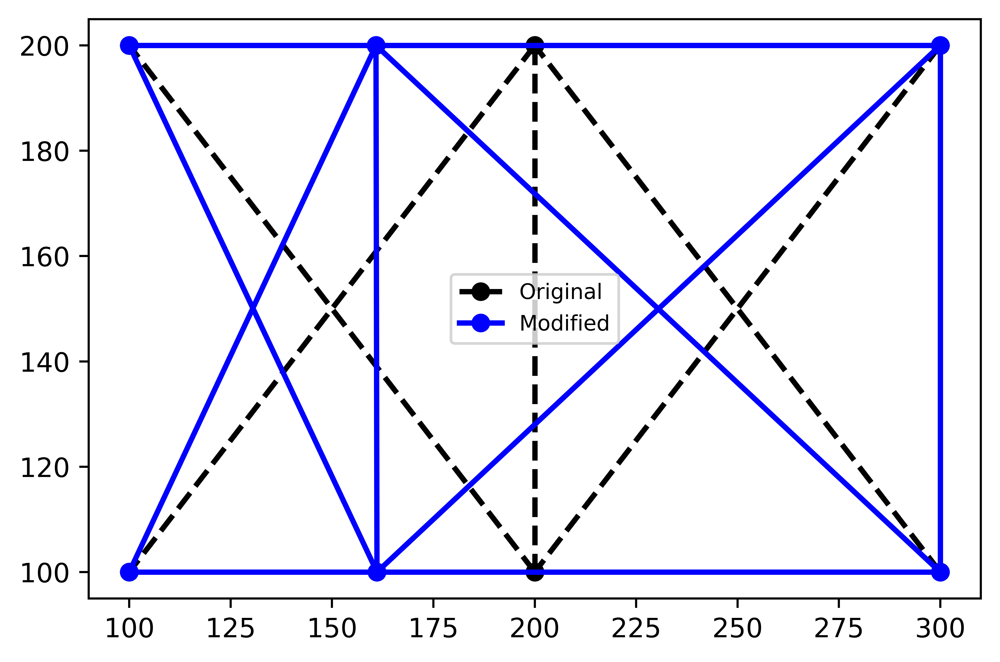

In [ ]:
basic.Plot(nodes, 'black', '--',2, 'Original')
basic.Plot(hh, 'b', '-',2, 'Modified')

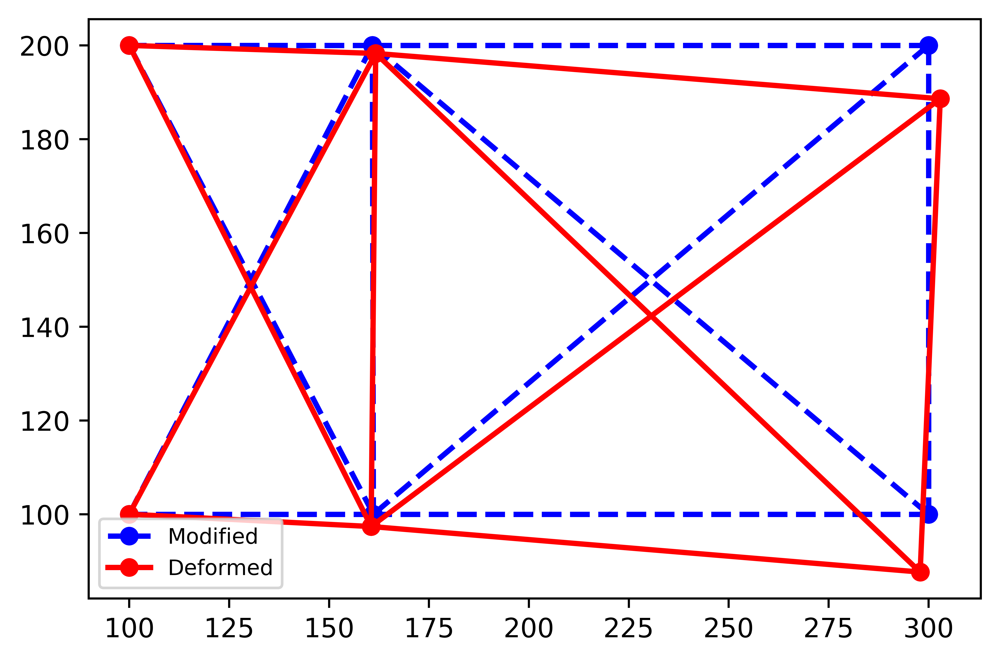

In [ ]:
basic.Plot(hh, 'b', '--',2, 'Modified')
scale = 100
Dnodes=  U_po*scale + hh
basic.Plot(Dnodes, 'r', '-',2, 'Deformed')

## GA (position) {only y -dir}
### Treating the areas as discrete values as cited from the litrature and optimizing only the topolgy

In [ ]:
@jax.jit
class position():
    def ga_solution(Nodes, Bar):

        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss =  np.abs(ans[1]) #+ np.abs(ans[2]).sum() +np.abs(ans[0]).sum()*0.0001 +
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -999 #"Unstable solution"

        #generate solutions
        solutions, position, global_best = [], [],[]


        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival))

        for p in range(1000):
            position.append(Nodes)
        
        for i in range(250):
            ranked_soln = []
            # print(solutions)
            for s, Nodes in zip(solutions,position):
                # print(s)
                ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

            # print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.sort()
            # ranked_soln.reverse()

            if ranked_soln[0][0] > 999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:100]
            global_best.append(ranked_soln[0])

            element_x, element_y = [], []
            for ix in range(6):
                    element_x.append(nodes[ix][0])
                    element_y.append(nodes[ix][1])

            new_pos_x, new_pos_y = [], []
            for iy in range(1000):
                xn1 = element_x[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                xn2 = element_x[1]#*np.random.uniform(0.80,1.20) #node1
                xn3 = element_x[2]#*np.random.uniform(0.80,1.20) #node2
                xn4 = element_x[3]#*np.random.uniform(0.80,1.20) #node3
                # xn5 = element_x*np.random.uniform(0.80,1.20) #node4
                # xn6 = element_x*np.random.uniform(0.80,1.20) #node5
                xn5 = element_x[4]
                xn6 = element_x[5]
                new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

                yn1 = element_y[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                yn2 = element_y[1]#*np.random.uniform(0.80,1.20) #node1
                yn3 = element_y[2]*np.random.uniform(0.80,1.20) #node2
                yn4 = element_y[3]*np.random.uniform(0.80,1.20) #node3
                # yn5 = element_y)*np.random.uniform(0.80,1.20) #node4
                # yn6 = element_y)*np.random.uniform(0.80,1.20) #node5
                yn5 = element_y[4]
                yn6 = element_y[5]
                new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

            # print(new_pos_x[0])
            # print(new_pos_y[0])

            new_pos_star = []
            for iq in range(1000):
                new_pos = []
                for iz in range(6):
                    new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
                new_pos_star.append(np.array(new_pos))
            position = new_pos_star
            if i%50==0:
                print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
            else:
                pass
        global_best.sort(reverse = True, key=lambda soln: soln[0])  
        return global_best[0]
        
position = jax.jit(position)

In [ ]:
ga_sol_p = position.ga_solution(nodes, bars)


The generation 0, best solution : 
optimization value : 0.0013259808819188485
area : [3.38, 4.18, 3.63, 3.13, 7.22, 1.62, 5.74, 2.88, 19.9, 11.5] 
deformations : [[300. 200.]
 [300. 100.]
 [200. 200.]
 [200. 100.]
 [100. 200.]
 [100. 100.]]


The generation 50, best solution : 
optimization value : 0.001035585650929412
area : [2.38, 5.74, 4.18, 5.74, 13.9, 3.09, 18.8, 2.38, 18.8, 11.5] 
deformations : [[300.         200.        ]
 [300.         100.        ]
 [200.         190.28366208]
 [200.         112.15562174]
 [100.         200.        ]
 [100.         100.        ]]


The generation 100, best solution : 
optimization value : 0.0011067366191052958
area : [1.62, 3.87, 4.18, 3.38, 3.84, 3.84, 18.8, 16.0, 4.97, 13.9] 
deformations : [[300.         200.        ]
 [300.         100.        ]
 [200.         210.01644335]
 [200.          81.67195347]
 [100.         200.        ]
 [100.         100.        ]]


The generation 150, best solution : 
optimization value : 0.0011819675123984

In [ ]:
ga_sol_p

(0.0013691909556329334,
 [3.38, 4.18, 3.63, 3.13, 7.22, 1.62, 5.74, 2.88, 19.9, 11.5],
 array([[300.        , 200.        ],
        [300.        , 100.        ],
        [200.        , 209.421055  ],
        [200.        , 119.13361489],
        [100.        , 200.        ],
        [100.        , 100.        ]]))

In [ ]:
hh = np.round(ga_sol_p[2],2)
hh

array([[300.  , 200.  ],
       [300.  , 100.  ],
       [200.  , 209.42],
       [200.  , 119.13],
       [100.  , 200.  ],
       [100.  , 100.  ]])

In [ ]:
S_po, M_po, U_po, c_po, R_po = Truss.TrussAnalysis(np.array(ga_sol_p[1]), hh, bars)

In [ ]:
S_po

array([ 17790.49699949,  16003.21477095, -23595.31012074,  20911.43520539,
        -6226.63784779, -20857.40526619,  24845.91449787, -16075.31834101,
        10211.91077349, -23794.86434391])

In [ ]:
M_po

730.3622409283006

In [ ]:
R_po

array([[-300000.        ,  114409.96482632],
       [ 300000.        ,   85590.03517368]])

In [ ]:
U_po

array([[ 0.03778033, -0.15720201],
       [-0.04869686, -0.17499251],
       [ 0.03075496, -0.06038826],
       [-0.01671597, -0.04155611],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ]])

In [ ]:
c_po

'Pass'

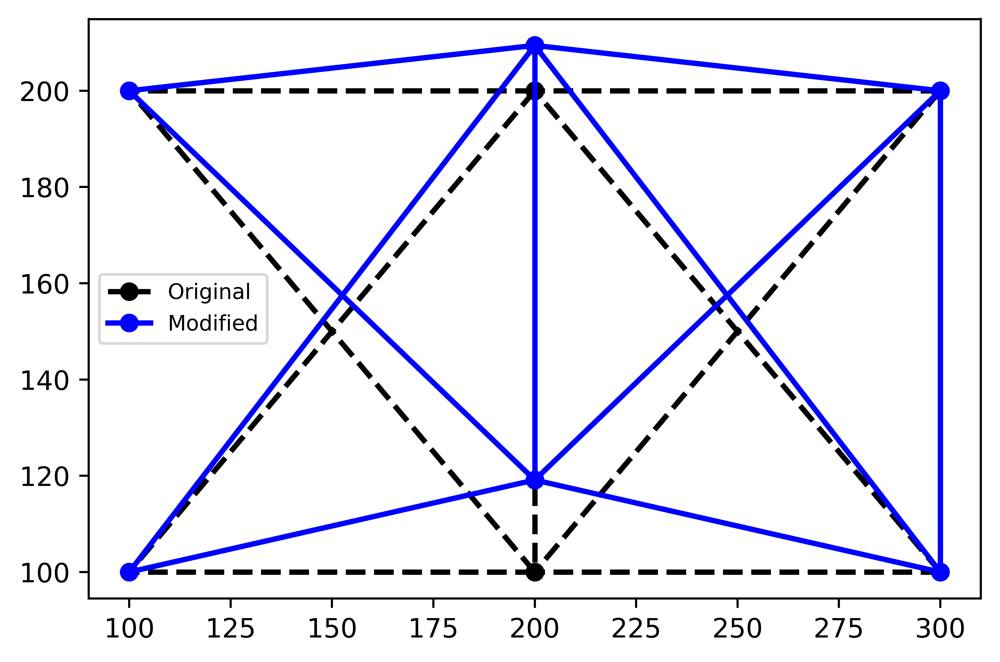

In [ ]:
basic.Plot(nodes, 'black', '--',2, 'Original')
basic.Plot(hh, 'b', '-',2, 'Modified')

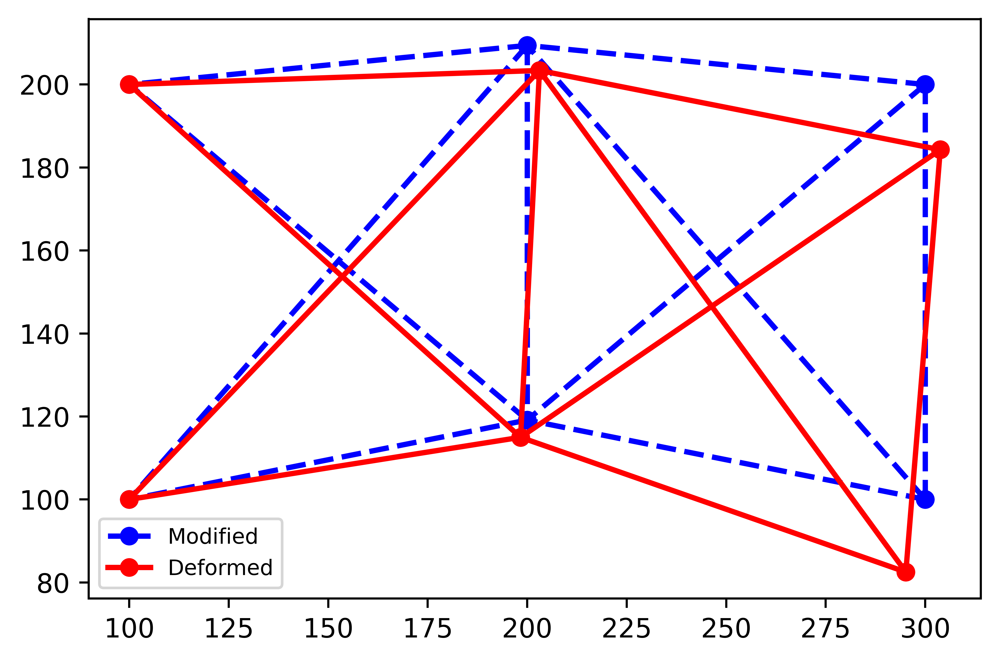

In [ ]:
basic.Plot(hh, 'b', '--',2, 'Modified')
scale = 100
Dnodes=  U_po*scale + hh
basic.Plot(Dnodes, 'r', '-',2, 'Deformed')

## GA (size + topology)
### optimizing for both shape size and topology treating the area as continous

In [ ]:
#algo
@jax.jit
class sol_1():
    def ga_solution(Nodes, Bar):
        # loss_list = []
        def fitness(Area, Nodes, Bar):
            ans = Truss.TrussAnalysis(Area, Nodes, Bar)
            
            loss =  np.abs(ans[1]) #+ np.abs(ans[2]).sum() np.abs(ans[0]).sum()*0.0001 +
            # loss_list.append(loss)
            # print(ans)
            #sum = ans.sum(axis=1)
            if ans[3]=='Pass':
                if loss == 0 :
                    return 99999
                else:
                    return abs(1/loss)
            else:
                return -999 #"Unstable solution"

        #generate solutions
        solutions, position, global_best = [], [], []


        for s in range(1000):
            solutions.append(basic.area_gen(area_avalival))

        for p in range(1000):
            position.append(Nodes)
        
        for i in range(250):
            ranked_soln = []
            # print(solutions)
            for s, Nodes in zip(solutions,position):
                # print(s)
                ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

            # print(ranked_soln)
            # ranked_soln = sorted(ranked_soln, reverse=True)
            #print(ranked_soln)
            ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
            # ranked_soln.reverse()

            if ranked_soln[0][0] >999:
                print(f'Gen {i} ======== Best Solution')
                #print(ranked_soln[0])
                break
            best_soln = ranked_soln[:100]
            global_best.append(ranked_soln[0])
            elements =[]
            for s in best_soln:
                elements.append(s[1][0])
                elements.append(s[1][1])
                elements.append(s[1][2])
                elements.append(s[1][3])
                elements.append(s[1][4])
                elements.append(s[1][5])
                elements.append(s[1][6])
                elements.append(s[1][7])
                elements.append(s[1][8])
                elements.append(s[1][9])

            new_gen = []
            for _ in range(1000):
                e1 = np.random.choice(elements)*np.random.uniform(0.95,1.05) #mutating all solns by 5%
                e2 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e3 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e4 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e5 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e6 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e7 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e8 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e9 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
                e10 = np.random.choice(elements)*np.random.uniform(0.95,1.05)

                new_gen.append(np.array([e1,e2,e3,e4,e5,e6,e7,e8,e9,e10]))
            
            solutions = new_gen

            element_x, element_y =[], []
            for ix in range(6):
                    element_x.append(nodes[ix][0])
                    element_y.append(nodes[ix][1])

            new_pos_x, new_pos_y = [], []
            for iy in range(1000):
                xn1 = element_x[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                xn2 = element_x[1]*np.random.uniform(0.80,1.20) #node1
                xn3 = element_x[2]*np.random.uniform(0.80,1.20) #node2
                xn4 = element_x[3]#*np.random.uniform(0.80,1.20) #node3
                # xn5 = element_x*np.random.uniform(0.80,1.20) #node4
                # xn6 = element_x*np.random.uniform(0.80,1.20) #node5
                xn5 = element_x[4]
                xn6 = element_x[5]
                new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

                yn1 = element_y[0]#*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
                yn2 = element_y[1]*np.random.uniform(0.80,1.20) #node1
                yn3 = element_y[2]*np.random.uniform(0.80,1.20) #node2
                yn4 = element_y[3]#*np.random.uniform(0.80,1.20) #node3
                yn5 = element_y[4]
                yn6 = element_y[5]
                new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

            # print(new_pos_x[0])
            # print(new_pos_y[0])

            new_pos_star = []
            for iq in range(1000):
                new_pos = []
                for iz in range(6):
                    new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
                new_pos_star.append(np.array(new_pos))
            position = new_pos_star
            #print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
        global_best.sort(reverse = True, key=lambda soln: soln[0])   
        #plt.plot(loss_list)
        return global_best[0]

In [ ]:
ga_sol = sol_1.ga_solution(nodes, bars)

In [ ]:
ga_sol

(4.249786017414289e-05,
 array([ 7.90586737, 10.2583536 , 10.35297396,  4.14430094,  4.70087084,
         4.97558523,  8.57749046,  3.44925075,  4.66303918,  4.04804809]),
 array([[100.        , 460.        ],
        [403.40331653, 443.36802112],
        [661.39910205, 395.58684413],
        [100.        , 100.        ],
        [460.        , 100.        ],
        [820.        , 100.        ]]))

In [ ]:
a = np.round(ga_sol[1],2)
d = np.round(ga_sol[2],2)
a, d

(array([ 7.91, 10.26, 10.35,  4.14,  4.7 ,  4.98,  8.58,  3.45,  4.66,
         4.05]), array([[100.  , 460.  ],
        [403.4 , 443.37],
        [661.4 , 395.59],
        [100.  , 100.  ],
        [460.  , 100.  ],
        [820.  , 100.  ]]))

In [ ]:
S, M, U, c, R = Truss.TrussAnalysis(a, d, bars)

In [ ]:
S

array([ 21736.42687425,   6988.28292169, -23669.64352295, -18649.95657432,
         5134.87785655,  14855.97016506,  21150.99143037, -24084.74920534,
        11744.2552181 , -15576.90695226])

In [ ]:
M

23531.58616053905

In [ ]:
R

array([[-300000.        ,  137732.56720016],
       [ 300000.        ,   62267.43279984]])

In [ ]:
U

array([[ 0.        ,  0.        ],
       [ 0.05539173, -0.1962107 ],
       [ 0.03832075, -0.38908491],
       [ 0.        ,  0.        ],
       [-0.08521072, -0.23749785],
       [-0.15235056, -0.54794518]])

In [ ]:
c

'Pass'

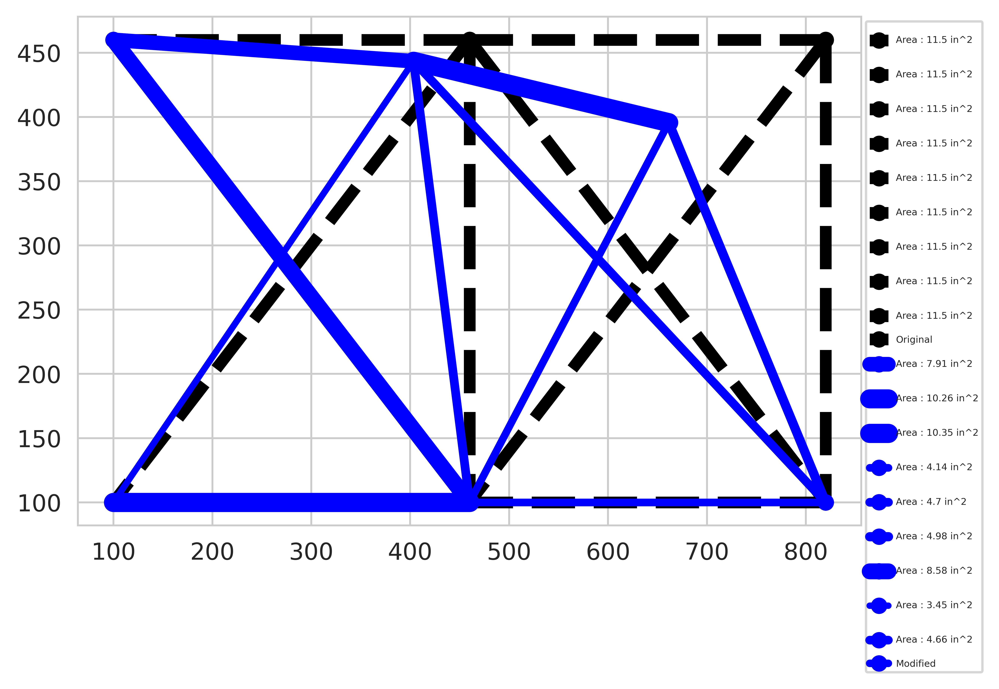

In [ ]:
basic.Plot(nodes, 'black', '--',[11.5]*10, 'Original')
basic.Plot(d, 'b', '-',a, 'Modified')
# scale = 100
# Dnodes=  U*scale + ga_sol[2]
# Plot(Dnodes, 'g', '-',1, 'Deformed')

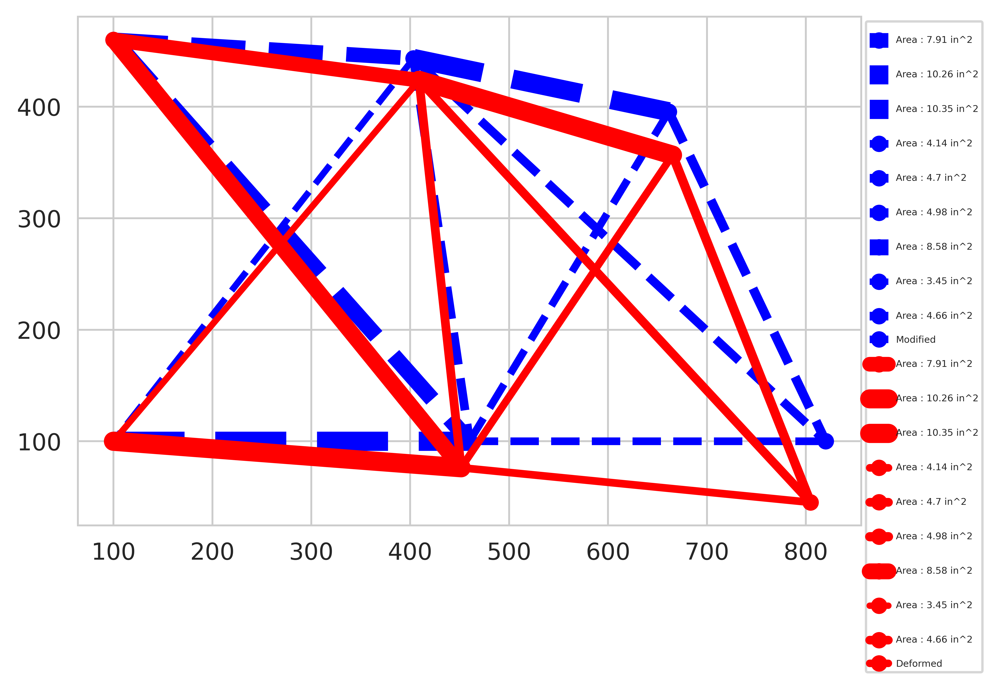

In [ ]:
basic.Plot(d, 'b', '--',a, 'Modified')
scale = 100
Dnodes=  U*scale + d
basic.Plot(Dnodes, 'r', '-',a, 'Deformed')

## GA (size + topology) 

In [ ]:
#algo
def ga_solution(Nodes, Bar):
    # loss_list = []
    def fitness(Area, Nodes, Bar):
        ans = Truss.TrussAnalysis(Area, Nodes, Bar)
        
        loss =np.abs(ans[1]) #np.abs(ans[0]).sum()*0.0001 + np.abs(ans[1]) + np.abs(ans[2]).sum()
        # loss_list.append(loss)
        # print(ans)
        #sum = ans.sum(axis=1)
        if ans[3]=='Pass':
            if loss == 0 :
                return 99999
            else:
                return abs(1/loss)
        else:
            return -999 #"Unstable solution"

    #generate solutions
    solutions, position, global_best = [], [], []


    for s in range(1000):
        solutions.append(basic.area_gen(area_avalival))

    for p in range(1000):
        position.append(Nodes)
    
    for i in range(250):
        ranked_soln = []
        # print(solutions)
        for s, Nodes in zip(solutions,position):
            # print(s)
            ranked_soln.append((fitness(np.array(s), Nodes, Bar),s,Nodes))

        # print(ranked_soln)
        # ranked_soln = sorted(ranked_soln, reverse=True)
        #print(ranked_soln)
        ranked_soln.sort(reverse = True, key=lambda soln: soln[0])
        # ranked_soln.reverse()

        if ranked_soln[0][0] >999:
            print(f'Gen {i} ======== Best Solution')
            #print(ranked_soln[0])
            break
        best_soln = ranked_soln[:100]
        global_best.append(ranked_soln[0])

        elements =[]
        for s in best_soln:
            elements.append(s[1][0])
            elements.append(s[1][1])
            elements.append(s[1][2])
            elements.append(s[1][3])
            elements.append(s[1][4])
            elements.append(s[1][5])
            elements.append(s[1][6])
            elements.append(s[1][7])
            elements.append(s[1][8])
            elements.append(s[1][9])

        new_gen = []
        for _ in range(1000):
            e1 = np.random.choice(elements)*np.random.uniform(0.95,1.05) #mutating all solns by 5%
            e2 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e3 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e4 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e5 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e6 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e7 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e8 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e9 = np.random.choice(elements)*np.random.uniform(0.95,1.05)
            e10 = np.random.choice(elements)*np.random.uniform(0.95,1.05)

            new_gen.append(np.array([e1,e2,e3,e4,e5,e6,e7,e8,e9,e10]))
        
        solutions = new_gen

        element_x, element_y =[], []
        for ix in range(6):
                element_x.append(nodes[ix][0])
                element_y.append(nodes[ix][1])

        new_pos_x, new_pos_y = [], []
        for iy in range(1000):
            xn1 = element_x[0]*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
            xn2 = element_x[1]*np.random.uniform(0.80,1.20) #node1
            xn3 = element_x[2]*np.random.uniform(0.80,1.20) #node2
            xn4 = element_x[3]#*np.random.uniform(0.80,1.20) #node3
            xn5 = element_x[4]
            xn6 = element_x[5]
            new_pos_x.append(np.array([xn1,xn2,xn3,xn4,xn5,xn6]))

            yn1 = element_y[0]*np.random.uniform(0.80,1.20) #mutating all solns by 5% #node0
            yn2 = element_y[1]*np.random.uniform(0.80,1.20) #node1
            yn3 = element_y[2]*np.random.uniform(0.80,1.20) #node2
            yn4 = element_y[3]#*np.random.uniform(0.80,1.20) #node3
            yn5 = element_y[4]
            yn6 = element_y[5]
            new_pos_y.append(np.array([yn1,yn2,yn3,yn4,yn5,yn6]))

        # print(new_pos_x[0])
        # print(new_pos_y[0])

        new_pos_star = []
        for iq in range(1000):
            new_pos = []
            for iz in range(6):
                new_pos.append([new_pos_x[iq][iz],new_pos_y[iq][iz]])
            new_pos_star.append(np.array(new_pos))
        position = new_pos_star
        #print(f'''\nThe generation {i}, best solution : \noptimization value : {ranked_soln[0][0]}\narea : {ranked_soln[0][1]} \ndeformations : {ranked_soln[0][2]}\n''')
    global_best.sort(reverse = True, key=lambda soln: soln[0])
    #plt.plot(loss_list)
    return global_best[0]

In [ ]:
ga_sol_const_base = ga_solution(nodes, bars)

In [ ]:
ga_sol_const_base

(4.1499709586499236e-05,
 array([9.39140489, 6.99573994, 7.7399449 , 5.13291445, 7.91261648,
        5.16460264, 5.65554343, 4.68758631, 7.78909266, 3.65850825]),
 array([[116.45294451, 501.38887285],
        [494.7437654 , 385.77588379],
        [683.4731894 , 447.08414957],
        [100.        , 100.        ],
        [460.        , 100.        ],
        [820.        , 100.        ]]))

In [ ]:
a = np.round(ga_sol_const_base[1],2)
d = np.round(ga_sol_const_base[2],2)
a,d

(array([9.39, 7.  , 7.74, 5.13, 7.91, 5.16, 5.66, 4.69, 7.79, 3.66]),
 array([[116.45, 501.39],
        [494.74, 385.78],
        [683.47, 447.08],
        [100.  , 100.  ],
        [460.  , 100.  ],
        [820.  , 100.  ]]))

In [ ]:
S_const, M_const, U_const, c_const, R_const = Truss.TrussAnalysis(a, d, bars)

In [ ]:
S_const

array([ 21199.58933324,   5018.88805102, -23878.9126435 , -18487.23072963,
         6526.70761423,   5305.82506156,  19786.29476587, -20629.74406156,
        14493.59054886, -11805.9685411 ])

In [ ]:
M_const

24097.906044926523

In [ ]:
U_const

array([[ 0.        ,  0.        ],
       [ 0.02481666, -0.20571657],
       [ 0.0933976 , -0.38462373],
       [ 0.        ,  0.        ],
       [-0.08596409, -0.21117748],
       [-0.15251812, -0.50262402]])

In [ ]:
c_const

'Pass'

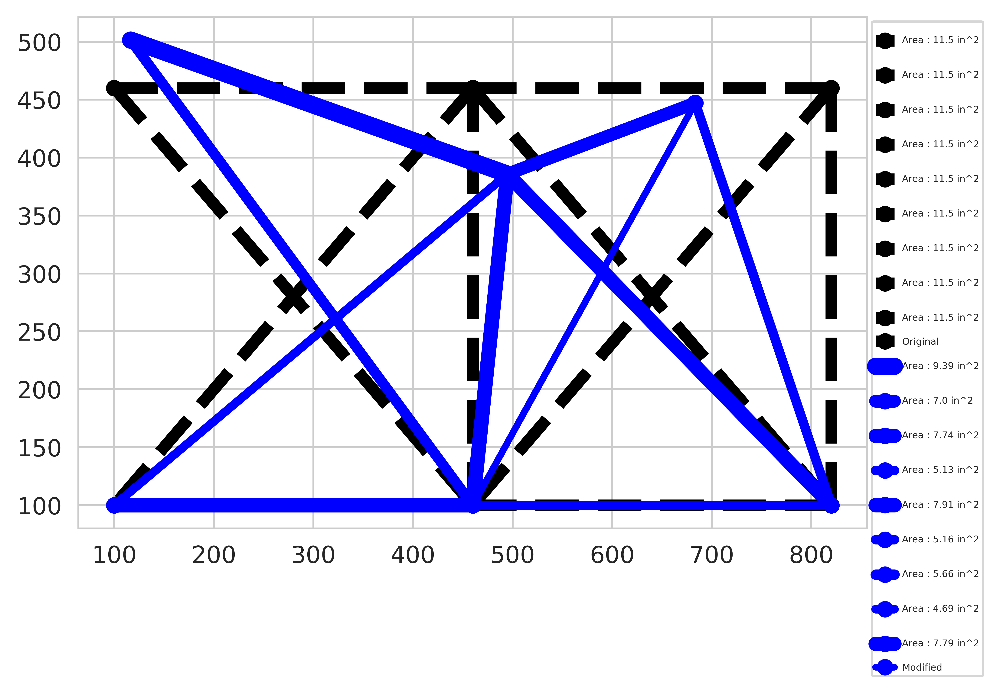

In [ ]:
basic.Plot(nodes, 'black', '--',[11.5]*10, 'Original')
basic.Plot(d, 'b', '-',a, 'Modified')
# scale = 100
# Dnodes=  U*scale + ga_sol[2]
# Plot(Dnodes, 'g', '-',1, 'Deformed')

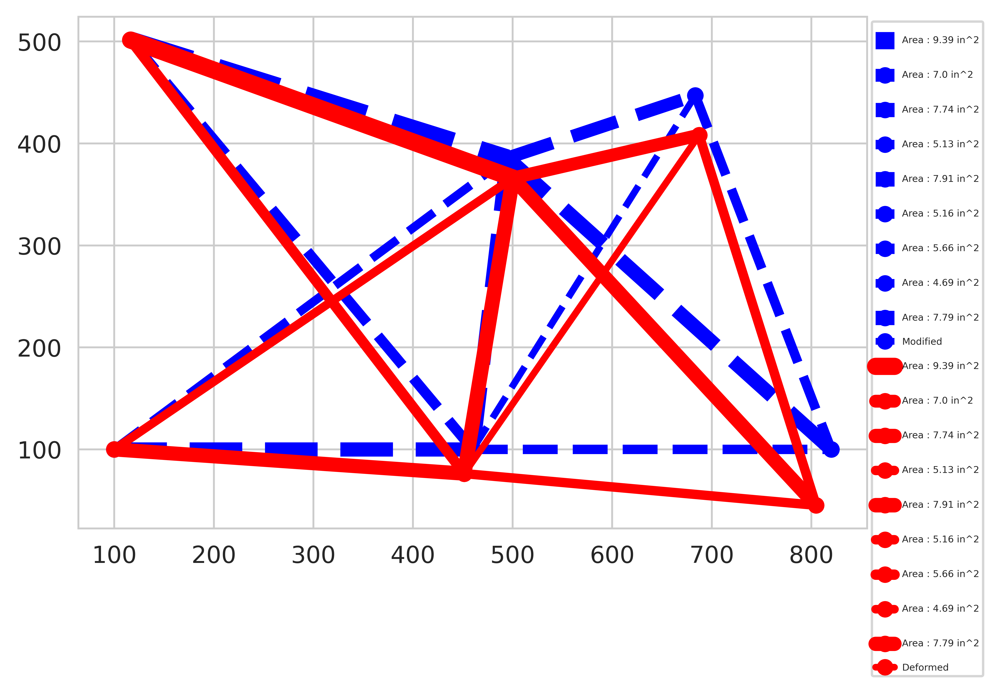

In [ ]:
basic.Plot(d, 'b', '--',a, 'Modified')
scale = 100
Dnodes=  U*scale + d
basic.Plot(Dnodes, 'r', '-',a, 'Deformed')

## Comparision plots

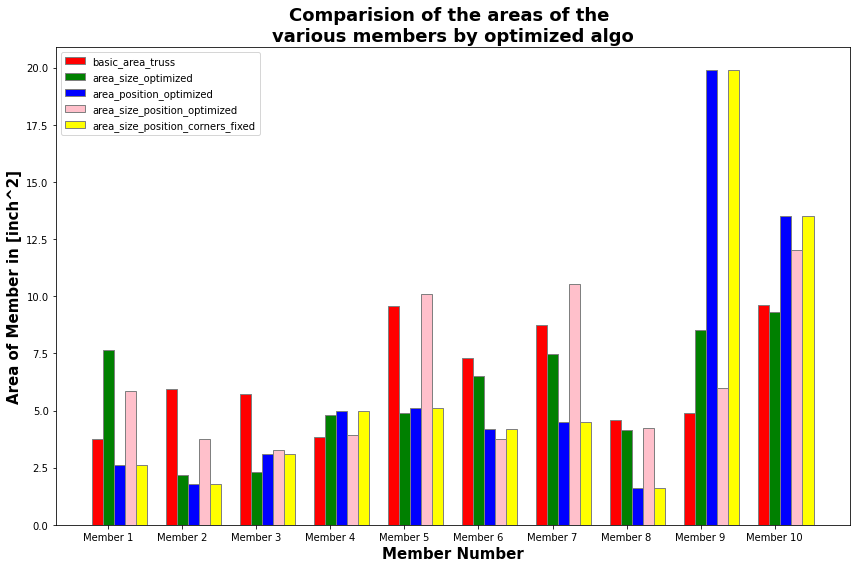

In [ ]:
lst=[]
for i in range(10):
    lst.append(f'Member {i+1}')
barWidth = 0.15
fig = plt.subplots(figsize =(12, 8))
 
# set height of bar
basic_area_truss = a
area_size_optimized = area
area_position_optimized = ga_sol_p[1]
area_size_position_optimized = np.round(ga_sol[1],2)
area_size_position_constant_base = np.round(ga_sol_const_base[1],2)
 
# Set position of bar on X axis
br1 = np.arange(len(basic_area_truss))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
 
# Make the plot
plt.bar(br1, basic_area_truss, color ='r', width = barWidth,
        edgecolor ='grey', label ='basic_area_truss')
plt.bar(br2, area_size_optimized, color ='g', width = barWidth,
        edgecolor ='grey', label ='area_size_optimized')
plt.bar(br3, area_position_optimized, color ='b', width = barWidth,
        edgecolor ='grey', label ='area_position_optimized')
plt.bar(br4, area_size_position_optimized , color ='pink', width = barWidth,
        edgecolor ='grey', label ='area_size_position_optimized')
plt.bar(br5, area_position_optimized, color ='yellow', width = barWidth,
        edgecolor ='grey', label ='area_size_position_corners_fixed')
 
# Adding Xticks
plt.xlabel('Member Number', fontweight ='bold', fontsize = 15)
plt.ylabel('Area of Member in [inch^2]', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(basic_area_truss))], lst)

plt.title("Comparision of the areas of the \nvarious members by optimized algo", fontweight='bold', fontsize=18)
plt.tight_layout()
plt.legend()
plt.show()

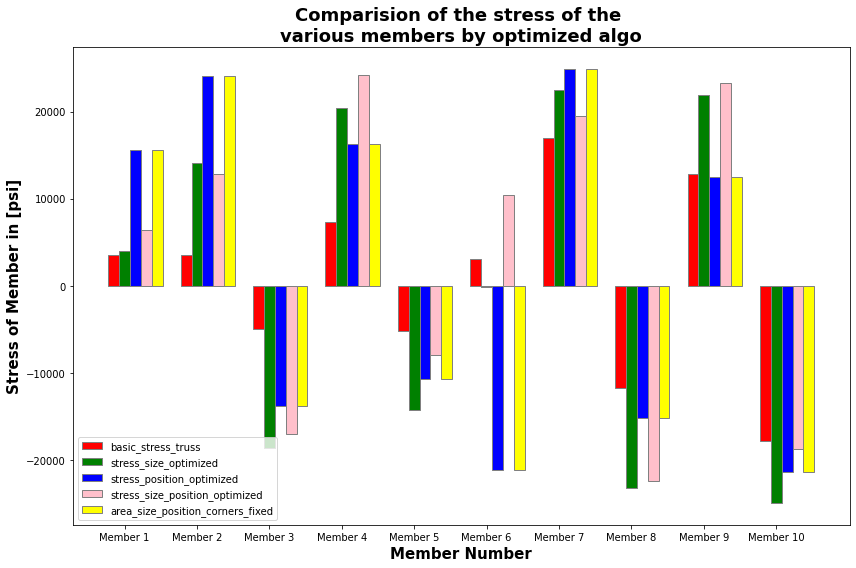

In [ ]:
lst=[]
for i in range(10):
    lst.append(f'Member {i+1}')
barWidth = 0.15
fig = plt.subplots(figsize =(12, 8))
 
# set height of bar
basic_area_truss = a_temp[0]
area_size_optimized = S_size
area_position_optimized = S_po
area_size_position_optimized = S
area_size_position_constant_base = S_const
 
# Set position of bar on X axis
br1 = np.arange(len(basic_area_truss))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
 
# Make the plot
plt.bar(br1, basic_area_truss, color ='r', width = barWidth,
        edgecolor ='grey', label ='basic_stress_truss')
plt.bar(br2, area_size_optimized, color ='g', width = barWidth,
        edgecolor ='grey', label ='stress_size_optimized')
plt.bar(br3, area_position_optimized, color ='b', width = barWidth,
        edgecolor ='grey', label ='stress_position_optimized')
plt.bar(br4, area_size_position_optimized , color ='pink', width = barWidth,
        edgecolor ='grey', label ='stress_size_position_optimized')
plt.bar(br5, area_position_optimized, color ='yellow', width = barWidth,
        edgecolor ='grey', label ='area_size_position_corners_fixed')
 

# Adding Xticks
plt.xlabel('Member Number', fontweight ='bold', fontsize = 15)
plt.ylabel('Stress of Member in [psi]', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(basic_area_truss))], lst)

plt.title("Comparision of the stress of the \nvarious members by optimized algo", fontweight='bold', fontsize=18)
plt.tight_layout()
plt.legend()
plt.show()

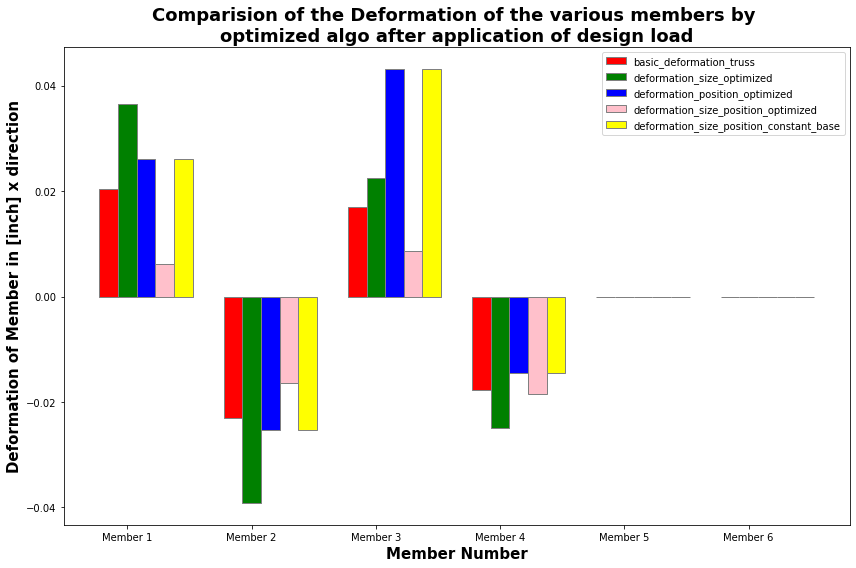

In [ ]:
lst=[]
for i in range(10):
    lst.append(f'Member {i+1}')
barWidth = 0.15
fig = plt.subplots(figsize =(12, 8))
 
# set height of bar
basic_area_truss = a_temp[2][:,0]
area_size_optimized = U_size[:,0]
area_position_optimized = U_po[:,0]
area_size_position_optimized = U[:,0]
area_size_position_constant_base = U_const[:,0]
 
# Set position of bar on X axis
br1 = np.arange(len(basic_area_truss))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
 
# Make the plot
plt.bar(br1, basic_area_truss, color ='r', width = barWidth,
        edgecolor ='grey', label ='basic_deformation_truss')
plt.bar(br2, area_size_optimized, color ='g', width = barWidth,
        edgecolor ='grey', label ='deformation_size_optimized')
plt.bar(br3, area_position_optimized, color ='b', width = barWidth,
        edgecolor ='grey', label ='deformation_position_optimized')
plt.bar(br4, area_size_position_optimized , color ='pink', width = barWidth,
        edgecolor ='grey', label ='deformation_size_position_optimized')
plt.bar(br5, area_position_optimized, color ='yellow', width = barWidth,
        edgecolor ='grey', label ='deformation_size_position_constant_base')
 

# Adding Xticks
plt.xlabel('Member Number', fontweight ='bold', fontsize = 15)
plt.ylabel('Deformation of Member in [inch] x direction', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(basic_area_truss))], lst)

plt.title("Comparision of the Deformation of the various members by \noptimized algo after application of design load", fontweight='bold', fontsize=18)
plt.tight_layout()
plt.legend()
plt.show()

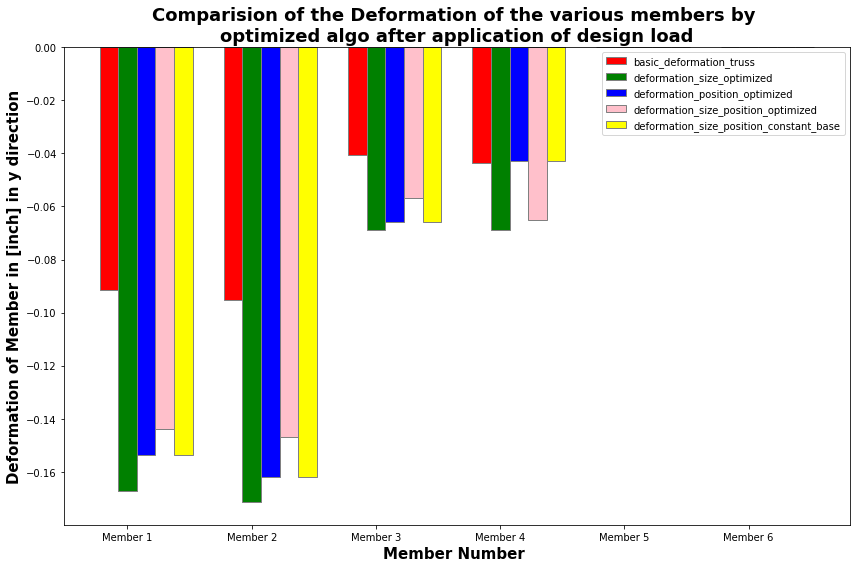

In [ ]:
lst=[]
for i in range(10):
    lst.append(f'Member {i+1}')
barWidth = 0.15
fig = plt.subplots(figsize =(12, 8))
 
# set height of bar
basic_area_truss = a_temp[2][:,1]
area_size_optimized = U_size[:,1]
area_position_optimized = U_po[:,1]
area_size_position_optimized = U[:,1]
area_size_position_constant_base = U_const[:,1]
 
# Set position of bar on X axis
br1 = np.arange(len(basic_area_truss))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
 
# Make the plot
plt.bar(br1, basic_area_truss, color ='r', width = barWidth,
        edgecolor ='grey', label ='basic_deformation_truss')
plt.bar(br2, area_size_optimized, color ='g', width = barWidth,
        edgecolor ='grey', label ='deformation_size_optimized')
plt.bar(br3, area_position_optimized, color ='b', width = barWidth,
        edgecolor ='grey', label ='deformation_position_optimized')
plt.bar(br4, area_size_position_optimized , color ='pink', width = barWidth,
        edgecolor ='grey', label ='deformation_size_position_optimized')
plt.bar(br5, area_position_optimized, color ='yellow', width = barWidth,
        edgecolor ='grey', label ='deformation_size_position_constant_base')
 

# Adding Xticks
plt.xlabel('Member Number ', fontweight ='bold', fontsize = 15)
plt.ylabel('Deformation of Member in [inch] in y direction', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(basic_area_truss))], lst)

plt.title("Comparision of the Deformation of the various members by \noptimized algo after application of design load", fontweight='bold', fontsize=18)
plt.tight_layout()
plt.legend()
plt.show()

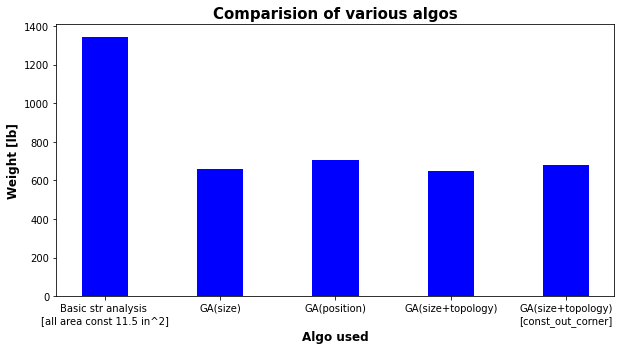

In [ ]:
data = {'Basic str analysis \n[all area const 11.5 in^2]':a_temp[1], 'GA(size)':M_size, 'GA(position)':M_po, 'GA(size+topology)':M,
      'GA(size+topology)\n[const_out_corner]':M_const,  }
Algo = list(data.keys())
values = list(data.values())
  
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(Algo, values, color ='b', alpha =1,
        width = 0.4)
 
plt.xlabel("Algo used", fontweight ='bold', fontsize = 12)
plt.ylabel("Weight [lb]", fontweight ='bold', fontsize = 12)
plt.title("Comparision of various algos", fontweight ='bold', fontsize = 15)
plt.show()

# New Section

In [ ]:
#modelling a graph neural netowrk in jraph
!pip install jraph

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 90 kB 7.4 MB/s 


In [ ]:
from jraph import GraphsTuple 
from jax import numpy as jnp

In [ ]:
key = jax.random.PRNGKey(0)
graph_1 = GraphsTuple(nodes=jax.random.normal(key, (3, 64)),
                  edges=jax.random.normal(key, (5, 64)),
                  senders=jnp.array([0,0,1,1,2]),
                  receivers=[1,2,0,2,1],
                  n_node=jnp.array([3]),
                  n_edge=jnp.array([5]),
                  globals=jax.random.normal(key, (1, 64)))

graph_2 = GraphsTuple(nodes=jax.random.normal(key, (5, 64)),
                  edges=jax.random.normal(key, (10, 64)),
                  senders=jnp.array([0,0,1,1,2,2,3,3,4,4]),
                  receivers=jnp.array([1,2,0,2,1,0,2,1,3,2]),
                  n_node=jnp.array([5]),
                  n_edge=jnp.array([10]),
                  globals=jax.random.normal(key, (1, 64)))
batch = graph.batch([graph_1, graph_2])


NameError: ignored